# Brewing Insights: Utilizing Cluster Analysis for Strategic Beer Type Selection in the Craft Beer Industry

**Names**: Nattanai Na Songkhla, Isabella Chang, Ram Sabyrkulov, Saniya Abushakimova

## 1. Introduction

**Research Introduction and Motivation**

The demand for specialty craft beers are on the rise. According to LinkedIn Senior Market Research Analyst, John Jack, the specialty beer market is expected to see an estimated increase of $141.28 billion between 2023 and 2027 [https://www.linkedin.com/pulse/beer-market-primed-remarkable-growth-anticipating-substantial-jack-ungfc/]. The anticipated demand in specialty beers is a clear motivation for a future business owner looking to open a specialty brewery to understand the different flavor profiles of beer. In doing so, this business owner would find the cluster analysis based on beer tasting useful. According to the article titled ‘Global Craft Beer Market Report and Forecast 2024-2032’ by Expert Market Research, [https://www.expertmarketresearch.com/reports/craft-beer-market] the article highlights how certain styles of beers like “Pilsners and Pale Lagers maintain their dominance in the market due to their versatile taste.” In that sense, certain beers are popular because of their versatile flavors, so the business owner would be motivated to include a simple range of beers in his inventory to match popular demands. Finally, according to the article titled ‘How Many Beer Styles Are There’ by Tapeville Social, [https://www.tapvillesocial.com/cheers-n-eats/2018/5/22/how-many-beer-styles-are-there], there are hundred of different beer styles in the world. With an overwhelming number of beer styles to choose from and the inability to include all types of beers in his inventory, a clustering analysis would be the most efficient way for the owner as it seeks to understand and find a representative sample of beers across different features. Overall, the aim and goal of the research project is to help the business owner find a representative category of beers to showcase to his customers through the cluster analysis.



**How research motivation impacts the desired type of clustering**

Moving forward with this research goal, the team expects our clustering results to produce clear distinct characteristics that would make for a good representation of beers selected. Therefore, the business owner would find it useful to have results that are ideally well-separated enough with no overlapping or fuzzy characteristics. Additionally, we want to make sure that our clustering result can capture most of the common crafted beer profile in the markets and avoid extraordinary profiles that would lead to singleton outliers. For example, dendrogram of HAC clustering with single linkage is not useful because our focus is on common beer styles only.

## 2. Dataset Discussion

**Dataset Display**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
#!pip install -U scikit-fuzzy
!pip install scikit-learn-extra

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 6.7 MB/s eta 0:00:00


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns

from sklearn_extra.cluster import KMedoids
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import adjusted_rand_score, silhouette_samples, silhouette_score
from sklearn.cluster import KMeans, AgglomerativeClustering
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram
#from skfuzzy.cluster import cmeans

from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE

# import random

import warnings
warnings.filterwarnings("ignore")
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore",category=ConvergenceWarning)

In [4]:
# Read the CSV file
raw = pd.read_csv('/content/drive/MyDrive/STAT437 Project/beer_profile_and_ratings.csv')

# Display the first few rows of the DataFrame
raw.head()

,Name,Style,Brewery,Beer Name (Full),Description,ABV,Min IBU,Max IBU,Astringency,Body,...,Fruits,Hoppy,Spices,Malty,review_aroma,review_appearance,review_palate,review_taste,review_overall,number_of_reviews
0,Amber,Altbier,Alaskan Brewing Co.,Alaskan Brewing Co. Alaskan Amber,"Notes:Richly malty and long on the palate, wit...",5.3,25,50,13,32,...,33,57,8,111,3.498994,3.636821,3.556338,3.643863,3.847082,497
1,Double Bag,Altbier,Long Trail Brewing Co.,Long Trail Brewing Co. Double Bag,"Notes:This malty, full-bodied double alt is al...",7.2,25,50,12,57,...,24,35,12,84,3.798337,3.846154,3.904366,4.024948,4.034304,481
2,Long Trail Ale,Altbier,Long Trail Brewing Co.,Long Trail Brewing Co. Long Trail Ale,Notes:Long Trail Ale is a full-bodied amber al...,5.0,25,50,14,37,...,10,54,4,62,3.409814,3.667109,3.600796,3.631300,3.830239,377
3,Doppelsticke,Altbier,Uerige Obergärige Hausbrauerei GmbH / Zum Uerige,Uerige Obergärige Hausbrauerei GmbH / Zum Ueri...,Notes:,8.5,25,50,13,55,...,49,40,16,119,4.148098,4.033967,4.150815,4.205163,4.005435,368
4,Sleigh'r Dark Doüble Alt Ale,Altbier,Ninkasi Brewing Company,Ninkasi Brewing Company Sleigh'r Dark Doüble A...,Notes:Called 'Dark Double Alt' on the label.Se...,7.2,25,50,25,51,...,11,51,20,95,3.625000,3.973958,3.734375,3.765625,3.817708,96


In [5]:
raw.shape

(3197, 25)

**Selected Variables**

In [6]:
raw.columns

Index(['Name', 'Style', 'Brewery', 'Beer Name (Full)', 'Description', 'ABV',
       'Min IBU', 'Max IBU', 'Astringency', 'Body', 'Alcohol', 'Bitter',
       'Sweet', 'Sour', 'Salty', 'Fruits', 'Hoppy', 'Spices', 'Malty',
       'review_aroma', 'review_appearance', 'review_palate', 'review_taste',
       'review_overall', 'number_of_reviews'],
      dtype='object')

In [7]:
df = raw.copy().drop(['Beer Name (Full)','Description','Min IBU','Max IBU',
                      'number_of_reviews','review_overall','review_aroma',
                      'review_appearance','review_palate','review_taste'],axis=1)
df.head()

,Name,Style,Brewery,ABV,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
0,Amber,Altbier,Alaskan Brewing Co.,5.3,13,32,9,47,74,33,0,33,57,8,111
1,Double Bag,Altbier,Long Trail Brewing Co.,7.2,12,57,18,33,55,16,0,24,35,12,84
2,Long Trail Ale,Altbier,Long Trail Brewing Co.,5.0,14,37,6,42,43,11,0,10,54,4,62
3,Doppelsticke,Altbier,Uerige Obergärige Hausbrauerei GmbH / Zum Uerige,8.5,13,55,31,47,101,18,1,49,40,16,119
4,Sleigh'r Dark Doüble Alt Ale,Altbier,Ninkasi Brewing Company,7.2,25,51,26,44,45,9,1,11,51,20,95


In [8]:
df.shape

(3197, 15)

In [9]:
df_num = df.copy().drop(['Name','Style','Brewery'],axis=1)
df_num.head()

,ABV,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
0,5.3,13,32,9,47,74,33,0,33,57,8,111
1,7.2,12,57,18,33,55,16,0,24,35,12,84
2,5.0,14,37,6,42,43,11,0,10,54,4,62
3,8.5,13,55,31,47,101,18,1,49,40,16,119
4,7.2,25,51,26,44,45,9,1,11,51,20,95


In [10]:
df_cat = df[['Style','Name','Brewery']]

Kaggle is a worldwide platform hosting 322,000 high-quality public datasets and offers an online community for data scientists. In preparing this analysis, our team of future data scientists downloaded the CSV file from Kaggle, titled ‘Beer Profile and Ratings Data Set,’ https://www.kaggle.com/datasets/ruthgn/beer-profile-and-ratings-data-set/data on Sunday, April 21st, 2024. The dataset was collected from BeerAdvocate and combines both the Beer Tasting Profiles Dataset by sp1222: https://www.kaggle.com/datasets/stephenpolozoff/top-beer-information and 1.5 Million Beer Reviews by Tanya Cashorali (uploaded by Datadoume): https://www.kaggle.com/datasets/rdoume/beerreviews. The dataset focuses on tasting profiles and consumer reviews of beers from different breweries. The goal of combining these two datasets is to provide a detailed consumer review of beer features, including taste, aroma, appearance, and other tasting profiles. Therefore, this dataset is inclusive of all possible types of observations. With that, a future business owner in the beer industry would find this analysis helpful because he would be interested in analyzing popular beer profiles, crucial consumer preferences, building the inventory, and optimizing sales and product offerings. In reviewing our dataset, we found several important features. Starting off, the dataset contains 3197 rows and 25 columns. The 3197 rows represent 3197 unique beers (observations). Additionally, the team analyzed several variables important for this analysis. Although there were many characteristics in the dataset, we only kept the variables focused solely on the tasting profiles that target categories such as Moutfeel (Astringency, Body, Alcohol), Taste (Bitter, Sweet, Sour, Salty), and Flavor And Aroma (Fruits, Hopy, Spices, Malty). These categories of predictors are important to a business owner whose focus is to understand distinct beer features.


## 3. Dataset Cleaning and Exploration

**Missing Value Detection and Cleaning**

In [11]:
df.isna().sum(axis=0)

Name           0
Style          0
Brewery        0
ABV            0
Astringency    0
Body           0
Alcohol        0
Bitter         0
Sweet          0
Sour           0
Salty          0
Fruits         0
Hoppy          0
Spices         0
Malty          0
dtype: int64

**Outlier Identification - Two Variable Outliers**

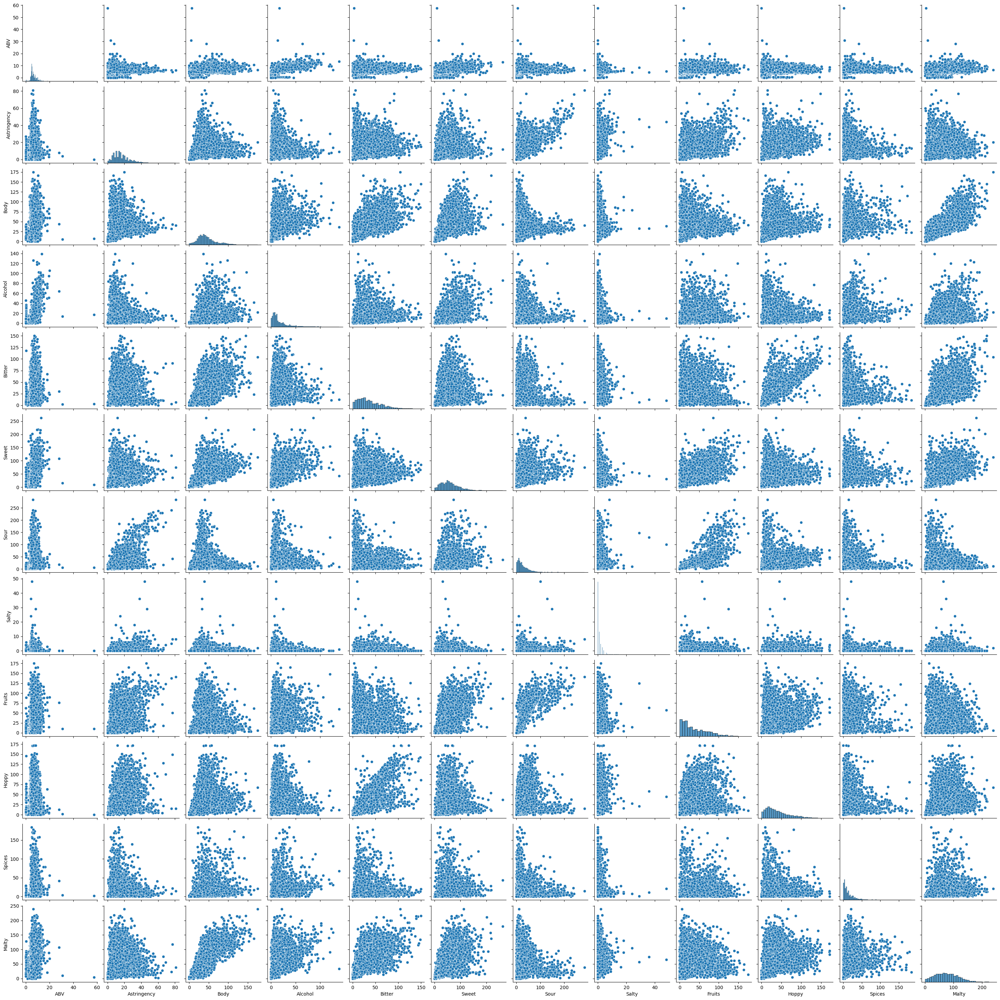

In [12]:
sns.pairplot(data=df)
plt.show()

**Outlier Identification - 3+ Variable Outliers**

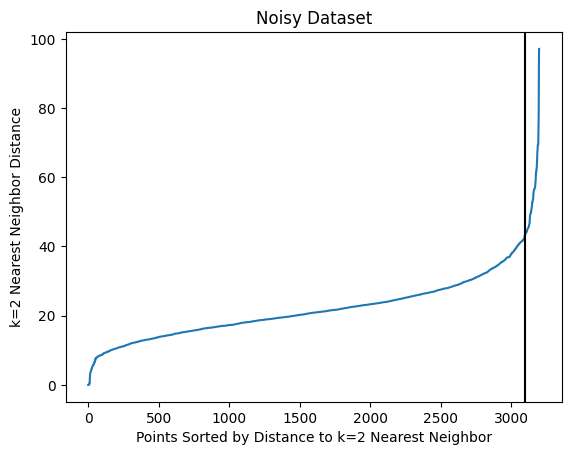

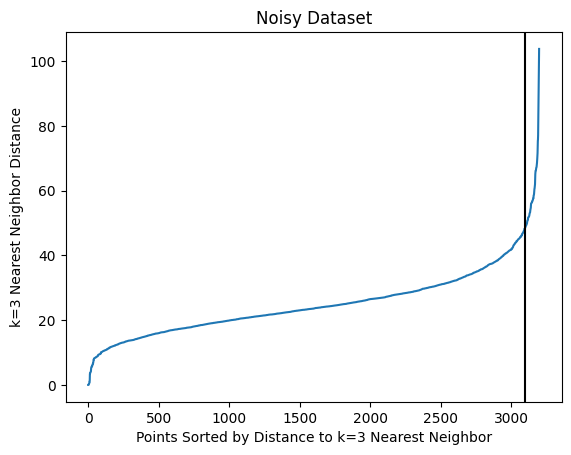

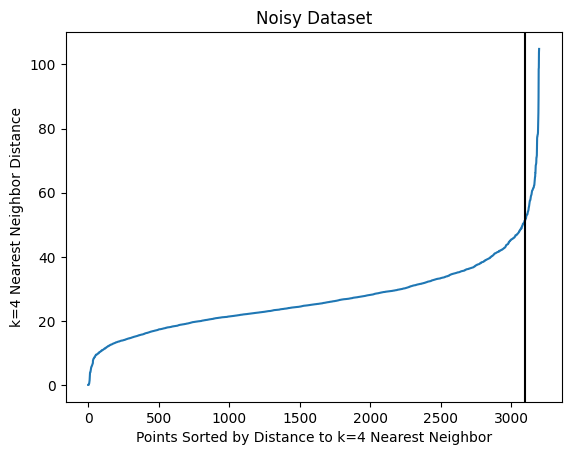

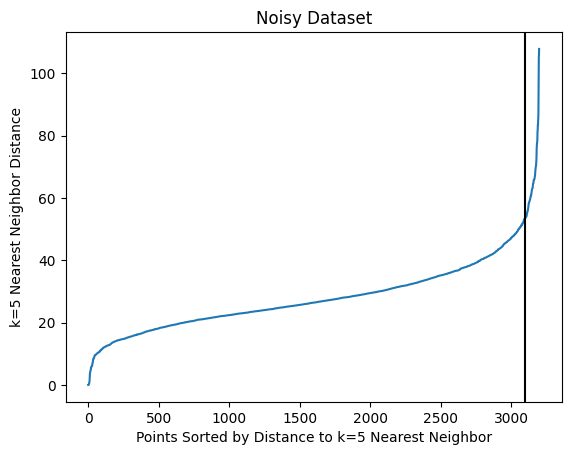

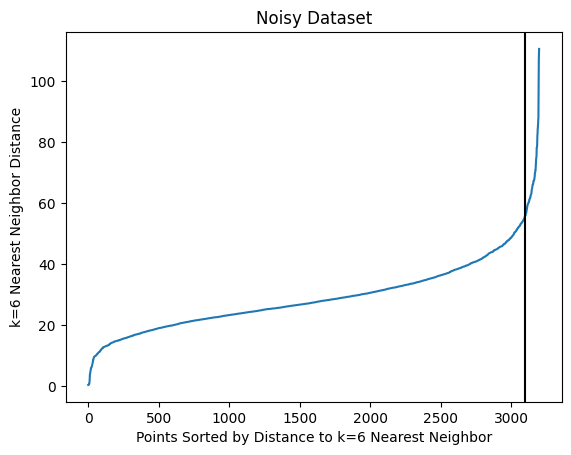

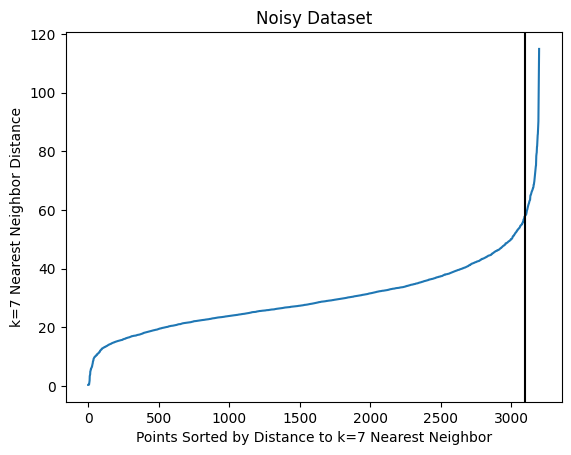

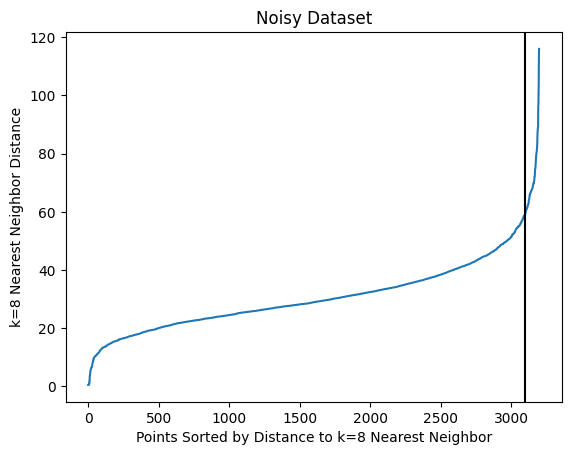

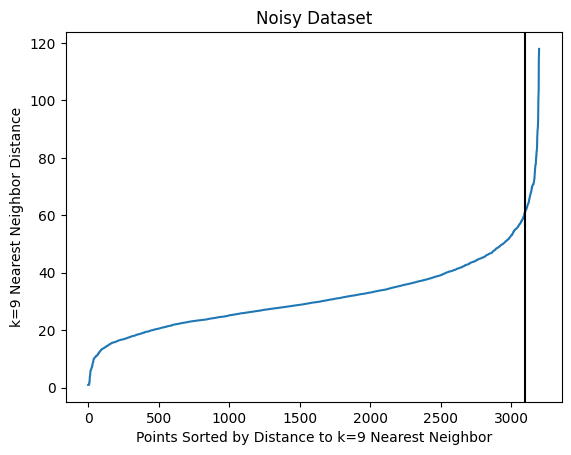

In [13]:
#Find the distance of the kth nearest neighbor
for k in range(2,10):
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(df_num)
    distances, indices = nbrs.kneighbors(df_num)

    plt.plot(np.sort(distances.T[k-1]))
    plt.axvline(x=len(df_num)-100, color='black')
    plt.xlabel('Points Sorted by Distance to k=%s Nearest Neighbor'%k)
    plt.ylabel('k=%s Nearest Neighbor Distance'%k)
    plt.title('Noisy Dataset')
    plt.show()

After selecting the dataset, we first explored the data to better understand it. We found no missing values, so there were no downsides to cleaning the dataset. Then, we chose to use the scatterplots and the KNN distance plot to determine if there were any outliers and noise. More specifically, the number of outliers in the distance plot was based on a range of k = (2,5), which all had similar outputs. The black vertical line indicates that there’s a handful of outliers (~100) beyond the vertical line on the right-hand side. In short, the two variable scatter plots indicated outliers. The KNN distance plot used to identify three plus variable outliers suggests additional outliers that were not able to be detected in the previous scatterplot. Overall, we trimmed 30 outliers to only include observations between 0 and 15 for the ‘ABV’ values. This is based on the summary statistics, which shows 75% of observations were between 0 and 15. In short, dropping some outliers for the ‘ABV’ predictor is necessary based on this statistic.


**Outlier Consideration**

In [14]:
df.describe()

,ABV,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
count,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000,3197.000000
mean,6.526688,16.515796,46.129496,17.055990,36.364404,58.270879,33.145449,1.017204,38.529559,40.924617,18.345637,75.330935
std,2.546997,10.410661,25.947842,17.331334,25.791152,34.281310,35.780172,2.132651,32.296646,30.403641,23.756582,39.909338
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,9.000000,29.000000,6.000000,17.000000,33.000000,11.000000,0.000000,12.000000,18.000000,4.000000,45.000000
50%,6.000000,14.000000,40.000000,11.000000,31.000000,54.000000,22.000000,0.000000,29.000000,33.000000,10.000000,73.000000
75%,7.600000,21.000000,58.000000,22.000000,52.000000,77.000000,42.000000,1.000000,60.000000,56.000000,23.000000,103.000000
max,57.500000,81.000000,175.000000,139.000000,150.000000,263.000000,284.000000,48.000000,175.000000,172.000000,184.000000,239.000000


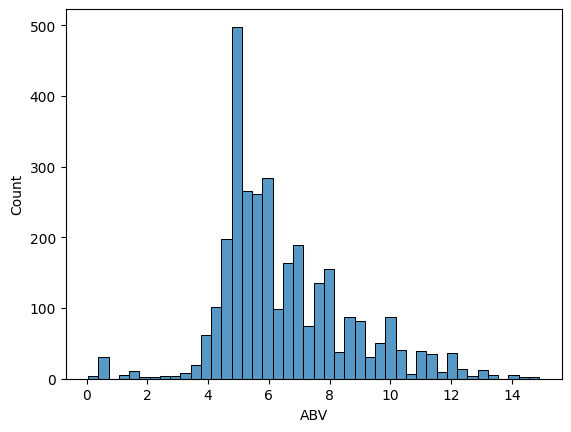

In [15]:
#Trim Outliers
Y = df_num[(df_num['ABV'] < 15) & (0 < df_num['ABV'])]
Y.shape
sns.histplot(Y['ABV'])
plt.show()

In dropping these outliers, this has several pros and cons. Advantages include improved accuracy, since outliers may skew the data and mislead results. Moreover, dropping outliers may prevent distorted clusters from forming when carrying out different algorithms. However, there are several disadvantages, including loss of information and introduction of subjectivity in determining what constitutes an outlier. Since we trimmed outliers, singleton clusters aren't needed because it is only useful if outliers are kept. Moreover, this logic also applies to larger clusters that happen to be further away. It would be ineffective to cluster larger clusters further away from each other if outliers are removed. Finally, it has a partial impact on our clustering algorithm selection since one of our clustering algorithms, K-medoids, is already robust to outliers but HAC with ward’s is not robust to outliers.

All in all, the noise consideration and trimming outliers is sufficient for this data cleaning step, since the dataset was already prepared well. There were no missing values to begin with and the dataset had thoughtfully combined two other datasets, so no additional data cleaning was needed. Finally, we dropped 30 outliers based on the KNN distance plot discussed above.  


## 4. Basic Descriptive Analytics

In [16]:
df['Style'].value_counts()

Style
Lager - Adjunct                    45
Lager - European Pale              43
Wheat Beer - Hefeweizen            42
Stout - Irish Dry                  42
Lambic - Fruit                     42
                                   ..
Bière de Champagne / Bière Brut     8
Lager - India Pale Lager (IPL)      6
IPA - New England                   4
Brett Beer                          3
Sour - Gose                         3
Name: count, Length: 111, dtype: int64

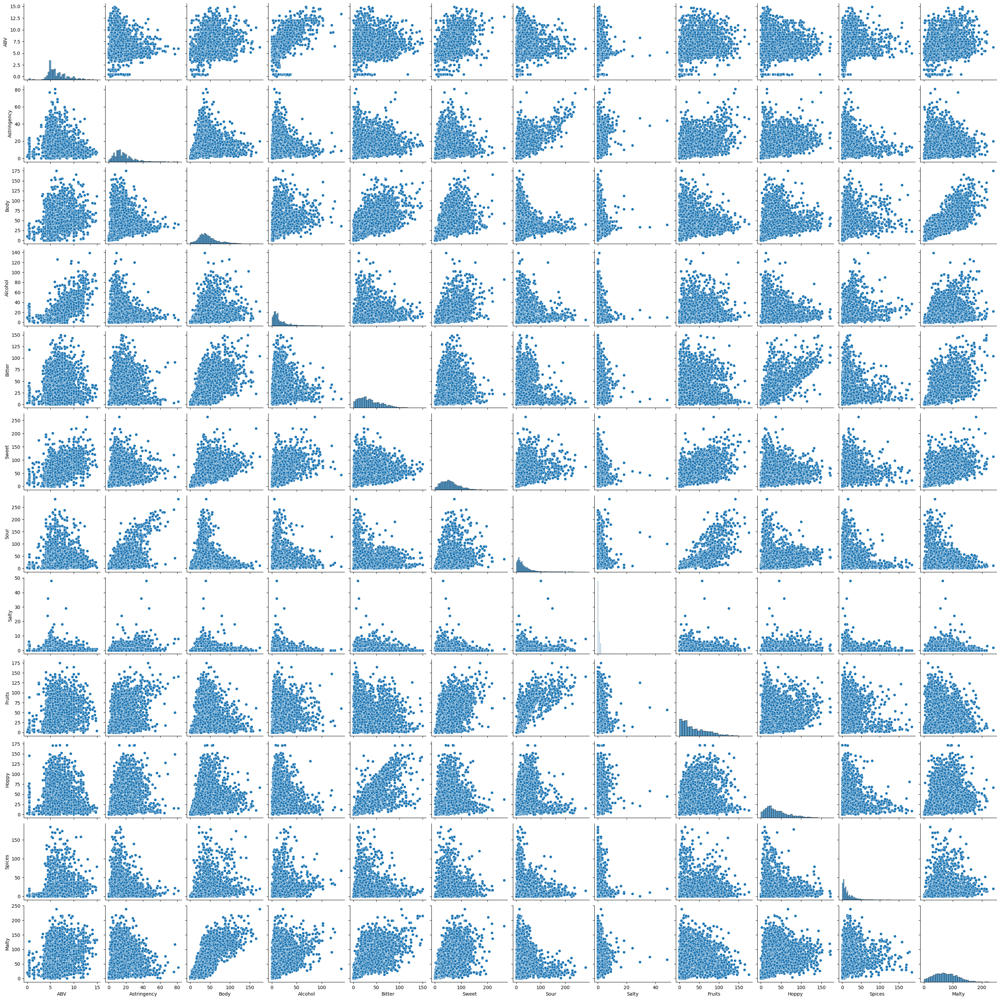

In [17]:
sns.pairplot(data=Y)
plt.show()

## 5. Scaling Decisions

Besides looking for any outliers and noise, another consideration in data analysis is determining if scaling is necessary. Based on the outputs of section 3, our scatter plots indicated outliers. Additionally, section 4’s summary statistics indicated high variances and skew across the different variables. For example, ‘Sour’, a tasting profile feature, originally had a standard deviation of 35.78 while ‘Salty,’ another profile predictor, only had a standard deviation of 2.13. The different variation across the variables highlighted a need to scale the dataset. Moreover, in preparation for the clustering algorithms chosen for the analysis, we also decided to scale the dataset to preserve the output reliability and accuracy of those algorithms discussed in later sections.

In [18]:
#Scaling
X = Y.copy()
st_tmp=StandardScaler()
tmp = st_tmp.fit_transform(X)
scale_data=pd.DataFrame(tmp, columns=X.columns)
scale_data.head()

,ABV,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
0,-0.540445,-0.345224,-0.546884,-0.462182,0.406605,0.468479,-0.007021,-0.47767,-0.170259,0.520930,-0.435580,0.891005
1,0.336120,-0.441289,0.416548,0.067239,-0.135853,-0.091253,-0.480731,-0.47767,-0.449337,-0.202718,-0.267525,0.214426
2,-0.678850,-0.249158,-0.354198,-0.638655,0.212870,-0.444768,-0.620058,-0.47767,-0.883459,0.422251,-0.603636,-0.336862
3,0.935874,-0.345224,0.339474,0.831956,0.406605,1.263888,-0.425001,-0.01033,0.325880,-0.038252,-0.099469,1.091473
4,0.336120,0.807564,0.185325,0.537834,0.290364,-0.385849,-0.675788,-0.01033,-0.852450,0.323571,0.068586,0.490069


## 6. Clusterability and Clustering Structure

**Does your analysis suggest that the dataset clusterable?**

In [19]:
def hopkins_stat(X, random_state=None):

    if random_state is not None:
        np.random.seed(random_state)

    #1. Calculating parameters
    n, d = X.shape
    p = int(0.1 * n)

    #2. Calculating the u and w distances
    nbrs = NearestNeighbors(algorithm='auto').fit(X)
    rand_ind = np.random.choice(range(0, n, 1), p)
    u_dist, _ = nbrs.kneighbors(np.random.uniform(np.min(X, axis=0), np.max(X, axis=0), (p, d)), 2)
    w_dist, _ = nbrs.kneighbors(X.iloc[rand_ind], 2)
    u_dist = u_dist[:, 1]
    w_dist = w_dist[:, 1]

    #3. Hopkin's Statistic
    h_stat = np.sum(w_dist) / (np.sum(u_dist) + np.sum(w_dist))

    return h_stat

In [20]:
num_trials=5
hopkins_stats=[]
for i in range(0,num_trials):
    hopkins_stats.append(hopkins_stat(scale_data, random_state=1))

mean_hs = sum(hopkins_stats)/num_trials
mean_hs

0.10210166433606686

After preparing the dataset for analysis, the team looked to confirm clusterability. To determine this, our team calculated the Hopkins statistic. The analysis showed a Hopkins statistic with a value of 0.10, indicating strong clusterability because the value was close to 0.

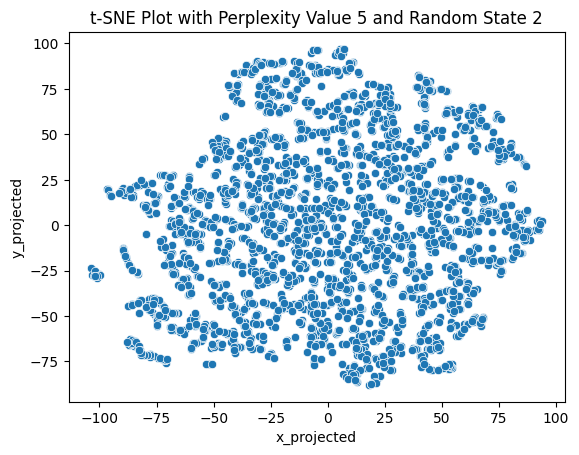

---------------------------------------------


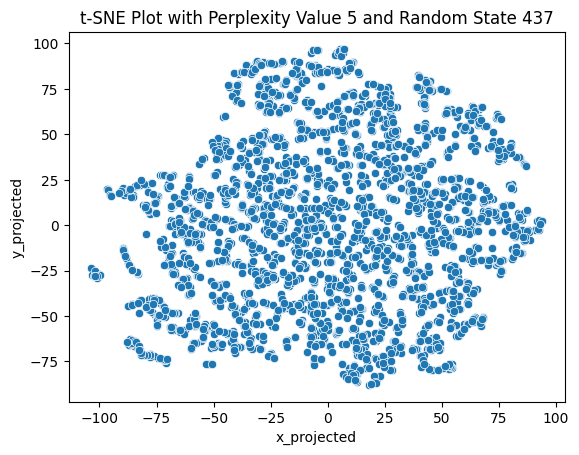

---------------------------------------------


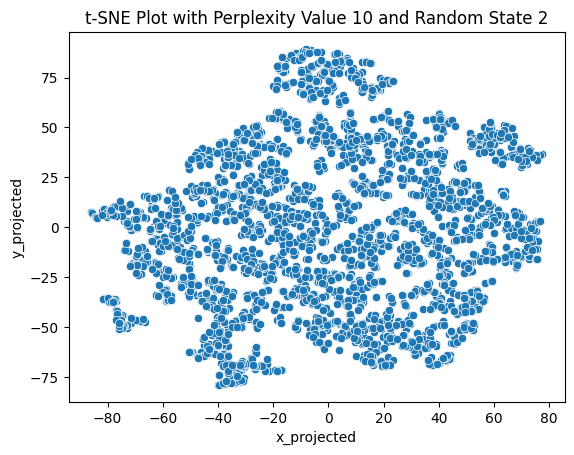

---------------------------------------------


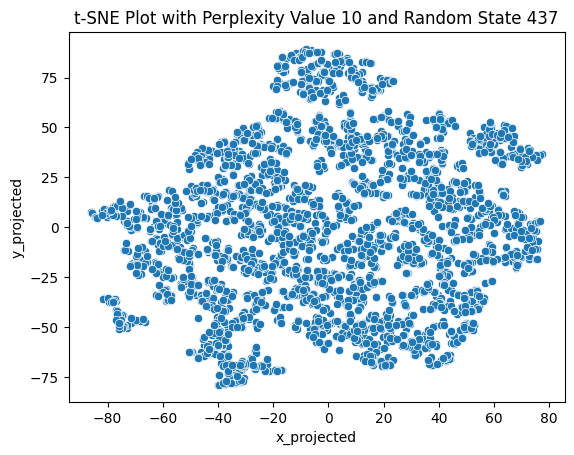

---------------------------------------------


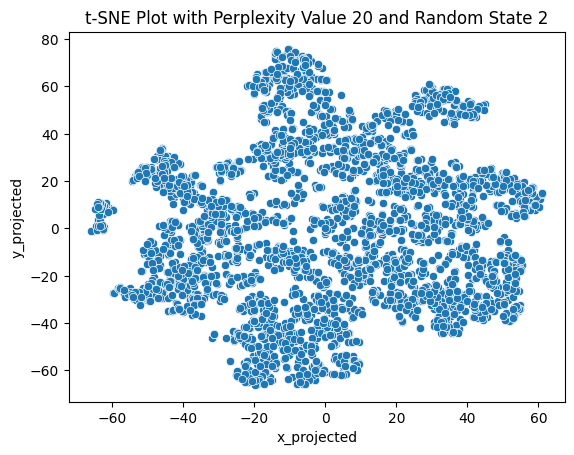

---------------------------------------------


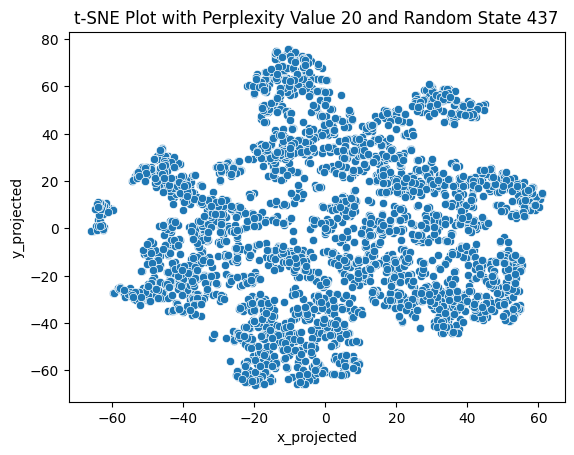

---------------------------------------------


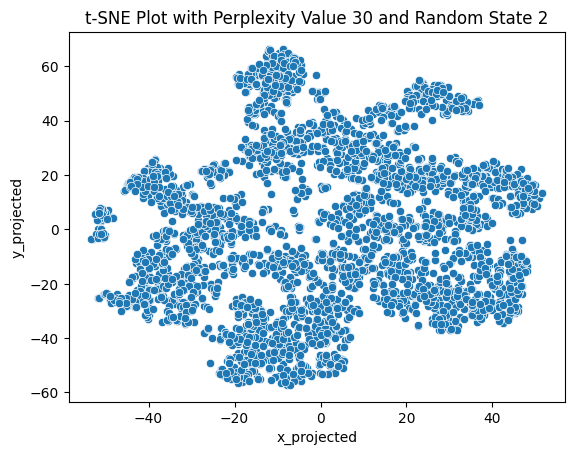

---------------------------------------------


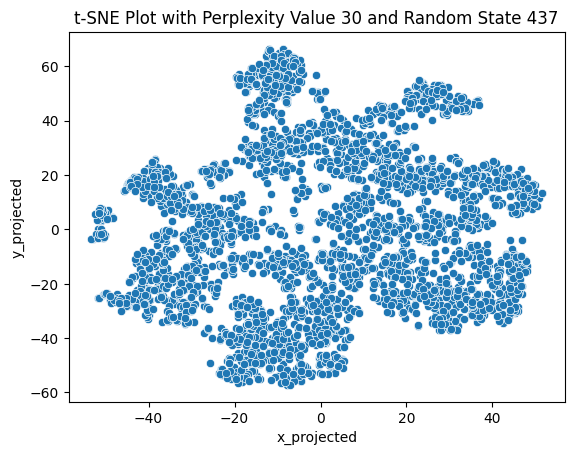

---------------------------------------------


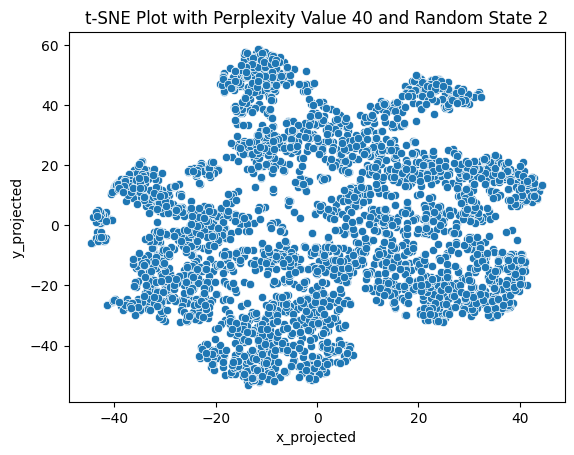

---------------------------------------------


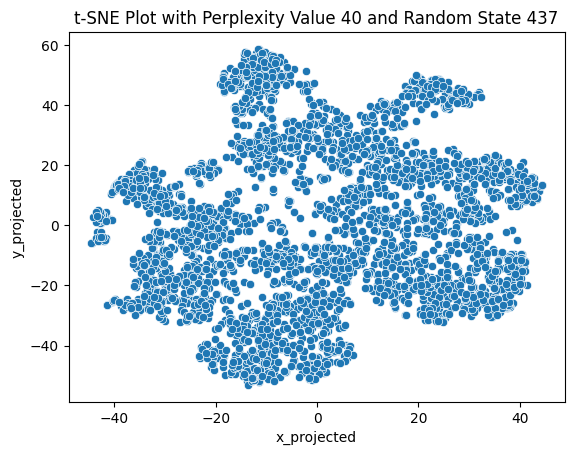

---------------------------------------------


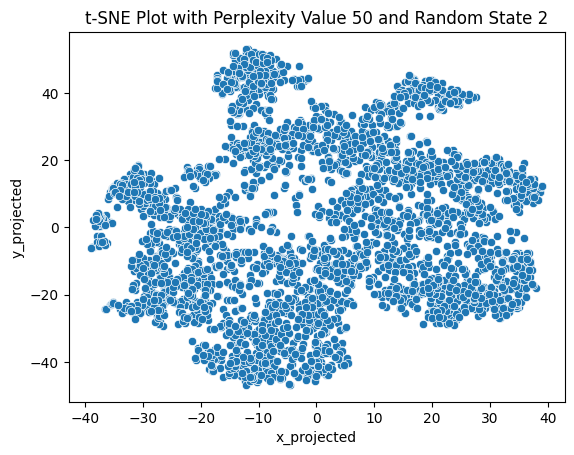

---------------------------------------------


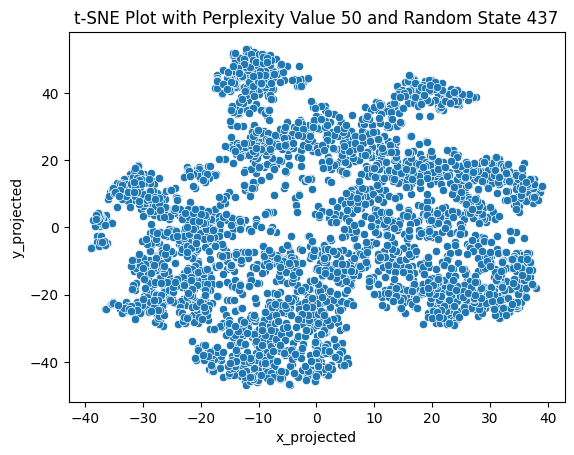

---------------------------------------------


In [21]:
for perp in [5, 10, 20, 30, 40, 50]:
  for rs in [2, 437]:
    tsne = TSNE(n_components=2,perplexity=perp,random_state=rs)
    data_tsne = tsne.fit_transform(scale_data)
    df_tsne = pd.DataFrame(data_tsne, columns=['x_projected','y_projected'])
    df_combo = pd.concat([scale_data,df_tsne],axis=1)
    sns.scatterplot(x='x_projected',y='y_projected',data=df_combo)
    plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(perp,rs))
    plt.show()
    print('---------------------------------------------')

Our team then decided to use the t-SNE plot with 6 different perplexities from 5 to 50 and random states from 2 to 437. Surprisingly, the t-SNE displayed a petal-shaped plot, where each of the petals represented a cluster with about 7 clusters total, which is confirmed in later sections. However, the plots show these clusters are not well-balanced in size and not well-separated. There could also be evidence of nested clusters since they are not well-separated.

**Clustering Structure and Attribute Association**

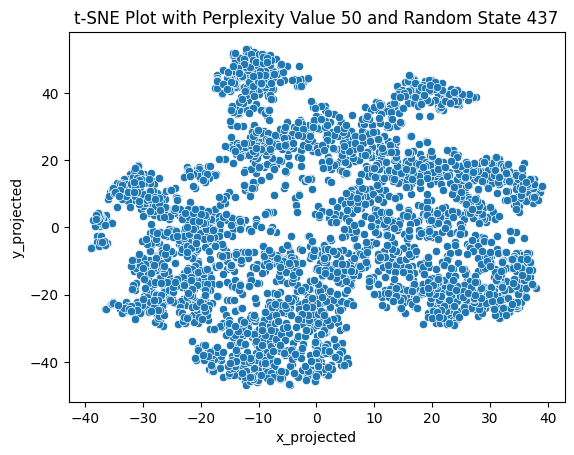

In [22]:
tsne = TSNE(n_components=2,perplexity=50,random_state=437)
data_tsne = tsne.fit_transform(scale_data)
df_tsne = pd.DataFrame(data_tsne, columns=['x_projected','y_projected'])
df_combo = pd.concat([scale_data,df_tsne],axis=1)
sns.scatterplot(x='x_projected',y='y_projected',data=df_combo)
plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(perp,rs))
plt.show()

The t-SNE plot above suggests there are roughly 7 clusters which are likely associated with Mouthfeel, Taste, and Flavor And Aroma, the different tasting profile categories that represent the attributes in our dataset. Although we have more than 7 attributes but roughly only 7 clusters, this may be evidence that some of the attributes are related closely to each other.

Although t-SNE helps to reveal important characteristics of our attributes in relation to clusterability, there are 4 properties in the original dataset that cannot be revealed in the t-SNE plot. For example, the original dataset shows outliers, can indicate the distance between objects, centroids and other summary statistics, and distance between clusters. The t-SNE plot cannot represent these properties and should be taken into account when understanding the dataset properly.

## 7. Clustering Algorithm Selection Motivation

**Clustering Algorithm #1: K-Medoids**

The first algorithm that we chose was k-Medoids. We know that the K-Medoids algorithm works best for data when the underlying clustering structure follows ideal properties, such as spherical clusters, have the same sparsity, good separation, only have numerical attributes, and does not have lots of noise or outliers. Looking at the t-SNE plot from section 6, we see that the inherent clusters are petal-shaped, not well-separated, and presumably have different numbers of objects in each cluster. The dataset also contains outliers and noise. Overall, we may notice that the dataset is not ideal for k-Medoids. However, we know that a deviation from “idealness” does not necessarily mean that the algorithm will not be able to cluster the dataset. We were particularly interested in k-Medoids because it is robust to outliers. K-medoids identifies 7 distinct clusters, which is the main research goal of the project. In identifying distinct clusters, the business owner is able to find a representative sample of beers to choose to showcase to his customers.

**Clustering Algorithm #2: HAC with Ward’s linkage**

The second algorithm that we used was HAC with Ward’s linkage. Initially, we assumed that out of 4 HAC algorithms with different linkages, the one with complete linkage would work best because it can identify clusters that are not well-separated and is not sensitive to outliers and noise. Surprisingly, HAC with Ward’s linkage outperformed HAC with Complete linkage even though the dataset did not look like an ideal one for HAC with Ward’s linkage. It managed to give more meaningful clusters that match the inherent clustering structure better, therefore, we have decided to proceed with this specific algorithm. Again, this algorithm also answers our research goal, which was to identify distinct clusters.

**Fuzzy c-means?**

Since our research motivation is to group different beer types, considering Fuzzy c-means is unnecessary for the same reasons noted in an earlier section. Moreover, we want to analyze the characteristics that different beer types share, not their membership score. In addition, we also want to reduce the number of beer types and subsequently reduce the choice overload for customers. Fuzzy c-means would conversely add another level of uncertainty and would increase the choice number even more. Unlike fuzzy c-means, hierarchical clustering is useful and has been justified in our analysis.  

## 8. Clustering Algorithm #1: K-Medoids

**Parameter Selection**

### Elbow Plot

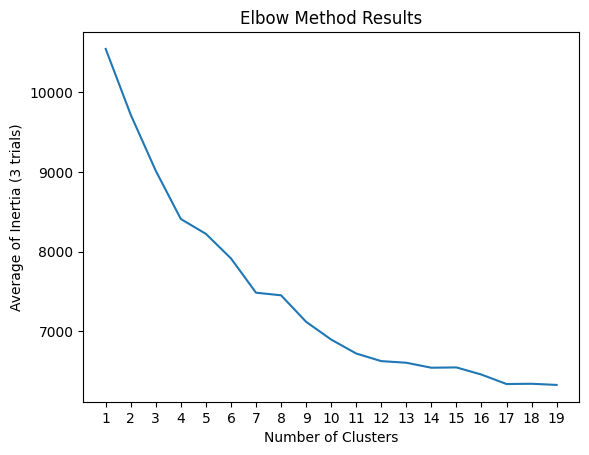

In [23]:
cluster_num_list=range(1,20)
avg_intertia_list=[]
for k in cluster_num_list:
  sub_inertia_list=[]
  for i in range(0,3):
    kmedoids = KMedoids(n_clusters = k).fit(scale_data)
    sub_inertia_list.append(kmedoids.inertia_)
  avg_intertia_list.append(np.average(sub_inertia_list))

plt.plot(cluster_num_list,avg_intertia_list)
plt.xlabel('Number of Clusters')
plt.ylabel('Average of Inertia (3 trials)')
plt.title('Elbow Method Results')
plt.xticks(cluster_num_list)
plt.show()

### Average Silhouette Score

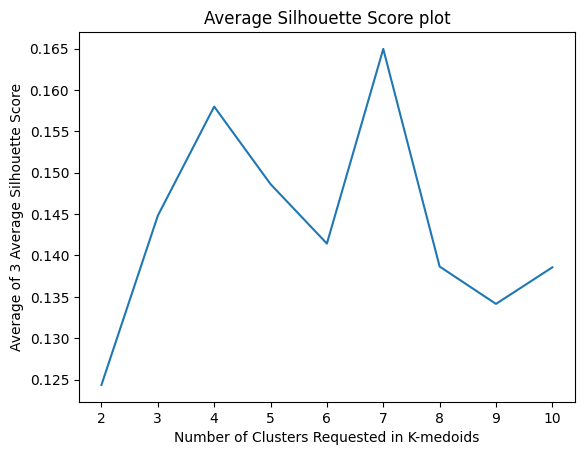

In [24]:
cluster_num_list = range(2,11)
trial_num = 3
avg_avg_sil_score_list = []
for k in cluster_num_list:
    avg_sil_score_list = []
    for i in range(0,trial_num):
        kmedoids = KMedoids(n_clusters=k).fit(scale_data)
        Y_pred = kmedoids.fit_predict(scale_data)
        avg_sil_score = silhouette_score(scale_data, Y_pred)
        avg_sil_score_list.append(avg_sil_score)
    avg_avg_sil_score_list.append(np.average(avg_sil_score_list))

plt.plot(cluster_num_list,avg_avg_sil_score_list)
plt.xlabel("Number of Clusters Requested in K-medoids")
plt.ylabel("Average of 3 Average Silhouette Score")
plt.title("Average Silhouette Score plot")
plt.show()

For k-Medoids, we need to choose the number of clusters. We can use an Elbow Plot and an Average Silhouette Plot. From the Elbow Plot, we can see an elbow at k=7 and from the Average Silhouette Plot, we can see that the highest Average Silhouette Score corresponds to k=7. So both of the methods agreed on k=7 being the most optimal number of clusters for the k-Medoids algorithm.

**Clustering the Data**

In [25]:
kmedoids = KMedoids(n_clusters=7, random_state=100).fit(scale_data)
df_centroids_encoded = pd.DataFrame(kmedoids.cluster_centers_,columns=scale_data.columns)
df_centroids_num = st_tmp.inverse_transform(df_centroids_encoded)
df_centroids = pd.DataFrame(df_centroids_num,columns=df_num.columns)
df_centroids

,ABV,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
0,5.4,21.0,36.0,10.0,18.0,39.0,75.0,1.0,73.0,20.0,20.0,66.0
1,8.5,9.0,49.0,42.0,50.0,89.0,17.0,0.0,34.0,39.0,17.0,104.0
2,8.0,13.0,52.0,25.0,15.0,100.0,33.0,0.0,58.0,31.0,45.0,88.0
3,5.0,15.0,84.0,8.0,55.0,65.0,15.0,0.0,19.0,35.0,9.0,119.0
4,5.0,28.0,41.0,10.0,43.0,51.0,27.0,2.0,26.0,63.0,9.0,79.0
5,6.5,14.0,52.0,13.0,62.0,71.0,36.0,0.0,39.0,80.0,10.0,91.0
6,5.0,12.0,16.0,3.0,15.0,15.0,12.0,0.0,9.0,21.0,5.0,29.0


**Clustering Algorithm Results Presentation**

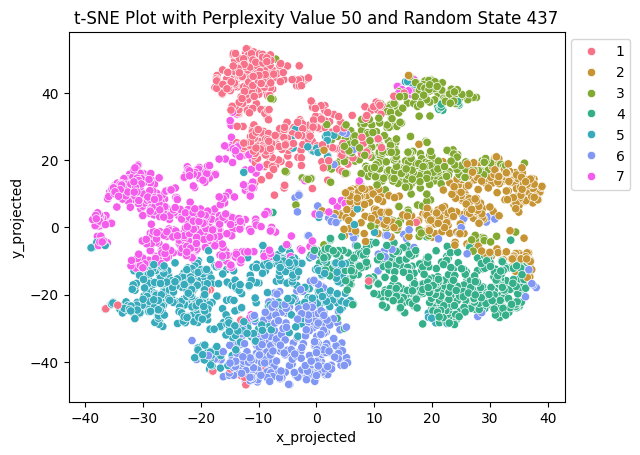

In [26]:
kmedoids = KMedoids(n_clusters=7, random_state=100).fit(scale_data)
df_combo['predicted_cluster_kmedoids'] = kmedoids.labels_
df_combo['predicted_cluster_kmedoids'] = df_combo['predicted_cluster_kmedoids']+1
sns.scatterplot(x='x_projected',y='y_projected',hue='predicted_cluster_kmedoids',
            palette=sns.color_palette('husl',7),data=df_combo)
plt.title('t-SNE Plot with k= %s' %k)
plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(50, 437))
plt.legend(bbox_to_anchor=(1,1))
plt.show()

Our main research goal was to find meaningful ways to group different beer types. From the t-SNE plot with cluster labels, we may observe that k-Medoids achieved this goal successfully. We can notice that the clusters form 7 distinct petals which group different types of beer in a meaningful way. Some slight deviations can be seen in Cluster 5 as some of its points were added to the inherent cluster which was supposed to consist of Cluster 6 points only (the bottom center cluster).

Looking at the t-SNE plot, we visually see inherent clusters to be in the shape of petals (like a flower). K-Medoids was able to identify these petals relatively well (except Clusters 5 and 6). Moreover, cluster 1 seems to have two subclusters, so K-Medoids merged two inherent clusters into one.

In [27]:
df_num2 = Y.copy().dropna()
df_num2['predicted_cluster_kmedoids'] = kmedoids.labels_+1
df2 = pd.concat([df_cat,df_num2], axis=1).dropna()

**Additional Cluster Exploration**

Cluster Sorted Similarity Matrix

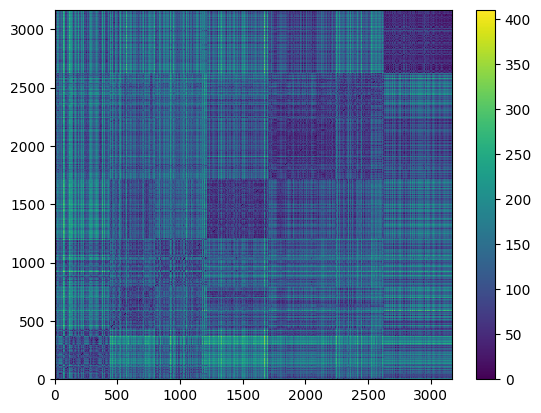

In [28]:
#Cluster similarity matrix
df_sort=df2.sort_values(by=['predicted_cluster_kmedoids']).drop(['predicted_cluster_kmedoids','Style','Name','Brewery'], axis=1)
dist_mat = squareform(pdist(df_sort))

#Then visualize the distance matrix with a heat map.
plt.pcolormesh(dist_mat)
plt.colorbar()
N = len(df_sort)
plt.xlim([0,N])
plt.ylim([0,N])
plt.show()

Besides the above cluster analysis, our team chose to further explore the data using several metrics. From the Cluster Sorted Similarity matrix, we see that clusters are close to each other because the heatmap colors that correspond to the distance between different clusters are mostly bluish (meaning the distance is very small).


For the purpose of this analysis, we have decided to use the Cluster Sorted Similarity matrix to check sparsity. From the heatmap, there are only two clusters whose sparsity might be smaller than others: two dark-colored squares (roughly 1200-1650 and 2600-3170). As we discussed previously, these squares should correspond to clusters 7 and 4, and should have the highest cohesiveness (meaning the smallest sparsity). The rest of the clusters should be more sparse than clusters 7 and 4.

Silhouette Plots

In [29]:
def show_silhouette_plots(X,cluster_labels):
    import matplotlib.cm as cm

    n_clusters=len(np.unique(cluster_labels))

    #create subplot
    fig, ax1 = plt.subplots(1,1)
    fig.set_size_inches(18,7)
    ax1.set_xlim([-0.1,1])
    ax1.set_ylim([1,len(X)+ 1 + (n_clusters+1)*10])

    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette score is :", silhouette_avg)

    sample_silhouette_values = silhouette_samples(X,cluster_labels)

    y_lower = 10
    for i in range(1,n_clusters+1):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels==i]
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        color = cm.nipy_spectral(float(i)/n_clusters)
        ax1.fill_betweenx(np.arange(y_lower,y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)
        ax1.text(-0.05, y_lower + 0.5*size_cluster_i, str(i))
        y_lower = y_upper + 10
        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")
        ax1.axvline(x=silhouette_avg, color="red",linestyle="--")
        ax1.set_yticks([])
        ax1.set_xticks([-0.1,0,0.2,0.4,0.6,0.8,1])

    plt.show()
    return

For n_clusters = 7 The average silhouette score is : 0.16495108453391347


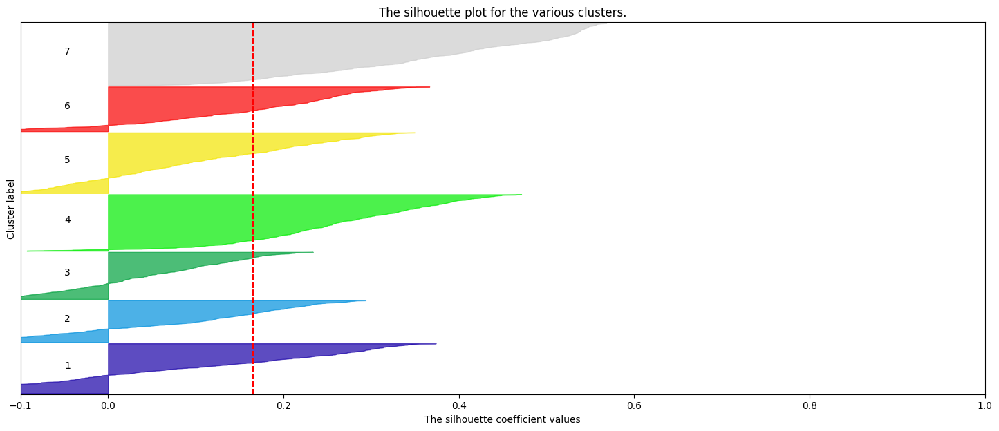

In [30]:
show_silhouette_plots(scale_data, df2["predicted_cluster_kmedoids"])

From the Silhouette Plot, we see that overall the clusters are not well-separated and roughly cohesive. The most well-separated and cohesive clusters are 7 (grey) and 4 (bright green). The rest of the clusters seem to be pretty close to each other because the number of negative silhouette scores for these clusters is higher than for Clusters 7 and 4. Moreover, we see that the bar plot shapes corresponding to these clusters are much sharper, meaning points are relatively less cohesive. We may notice the same trend from the Cluster Sorted Similarity matrix: the two darkest squares (roughly 1200-1650 and 2600-3170) correspond to Cluster 4 and Cluster 7 respectively because their cohesion is higher (the color is darker, meaning the distance is smaller compared to other clusters).

In conclusion, our metrics fit the data well. For example, K-Medoids algorithm did not result in singleton clusters, so using the Cluster-Sorted Similarity Matrix and Silhouette Plot to evaluate cohesion and separation is confirmed to be reasonable.

**Describing Each of the Clusters**

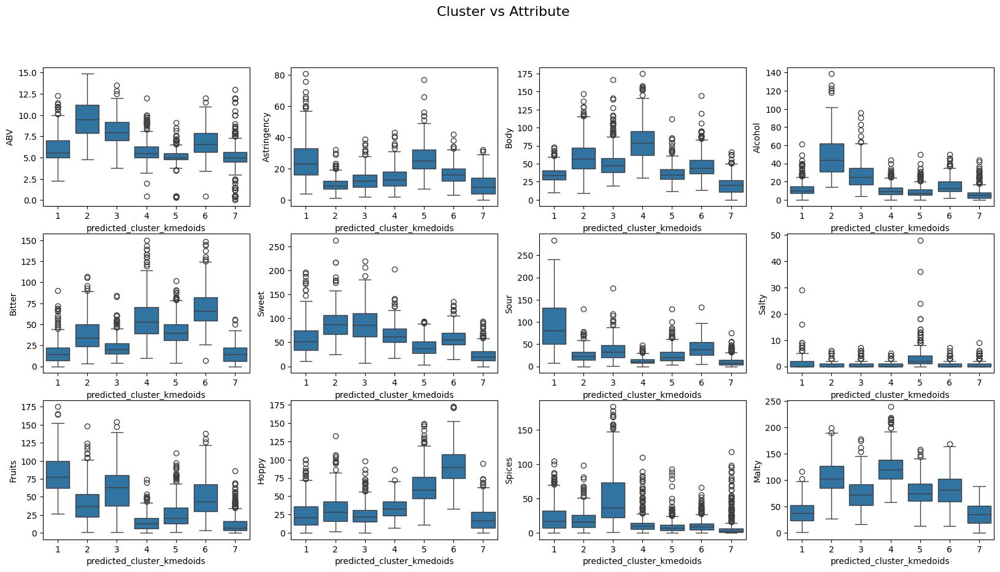

In [31]:
fig, ax = plt.subplots(3,4,figsize=(20,10))
fig.suptitle('Cluster vs Attribute', fontsize=16)

i=0
for col in df_num2.columns[0:-1]:
  sns.boxplot(ax=ax[int(np.floor(i/4)),int(i-4*np.floor(i/4))], x='predicted_cluster_kmedoids',y=col,data=df_num2)
  i = i+1
plt.show()

1. **Cluster 1: Wheat Beer (High Astringency/Sour/Fruity)**

According to the boxplot, we can see that cluster 1 has a very high Astringency mouth feel, with the highest sour taste and fruity flavor. Additionally, this cluster mostly composed of the Lambic, Wheat beer and some sour ale.

In [32]:
# Cluster 1
df2[df2['predicted_cluster_kmedoids']==1]['Style'].value_counts().head(6)

Style
Lambic - Fruit             41
Wheat Beer - Hefeweizen    32
Wheat Beer - Witbier       28
Farmhouse Ale - Saison     28
Lambic - Gueuze            24
Sour - Flanders Red Ale    24
Name: count, dtype: int64

2. **Cluster 2: Strong Ale (Highest ABV/Sweet/Malty)**

According to the boxplot, we can see that cluster 2 has the highest alcohol content, with a sweet taste and malty flavor. Additionally, this cluster mostly composed of Barleywine, Strong ale and some Bock.

In [33]:
# Cluster 2
df2[df2['predicted_cluster_kmedoids']==2]['Style'].value_counts().head(10)

Style
Barleywine - American        32
Scotch Ale / Wee Heavy       29
Lager - European Strong      25
Old Ale                      24
Bock - Doppelbock            22
Stout - Russian Imperial     22
Barleywine - English         20
Strong Ale - English         18
Strong Ale - American        17
Stout - American Imperial    16
Name: count, dtype: int64

3. **Cluster 3: Dark Beer (High ABV/Sweet/Spicy & Fruity)**

According to the boxplot, we can see that cluster 3 also has high alcohol content, with a sweet taste, as well as spicy and fruity  flavor. Additionally, this cluster mostly composed of Dubbel and Dark ale.

In [34]:
# Cluster 3
df2[df2['predicted_cluster_kmedoids']==3]['Style'].value_counts().head(10)

Style
Dubbel                       38
Strong Ale - Belgian Dark    36
Tripel                       27
Quadrupel (Quad)             23
Strong Ale - Belgian Pale    23
Bock - Weizenbock            21
Winter Warmer                18
Pumpkin Beer                 17
Smoked Beer                  15
Brown Ale - Belgian Dark     14
Name: count, dtype: int64

4. **Cluster 4: Roasted Ale (Full Body/Bitter/Malty)**

According to the boxplot, we can see that cluster 4 has full body mouth feel, with a bitter taste, and malty flavor. Additionally, this cluster mostly composed of Porter and Stout.

In [35]:
# Cluster 4
df2[df2['predicted_cluster_kmedoids']==4]['Style'].value_counts().head(6)

Style
Porter - English       34
Brown Ale - English    34
Stout - Irish Dry      33
Stout - Oatmeal        29
Porter - American      28
Lager - Schwarzbier    26
Name: count, dtype: int64

5. **Cluster 5: Pilsner (High Astringency/Bitter & Salty/Hoppy)**

According to the boxplot, we can see that cluster 5 has a very high Astringency mouth feel, with the bitter and salty taste, as well as hoppy flavor. Additionally, this cluster mostly composed of the Pilsner and some Lager.

In [36]:
# Cluster 5
df2[df2['predicted_cluster_kmedoids']==5]['Style'].value_counts().head(6)

Style
Pilsner - German                34
Lager - Helles                  33
Kölsch                          30
Pilsner - Bohemian / Czech      27
Lager - Märzen / Oktoberfest    25
Lager - Vienna                  23
Name: count, dtype: int64

6. **Cluster 6: IPA (High ABV, most Bitter/Hoppy & Fruity)**

According to the boxplot, we can see that cluster 6 has high alcohol content, with the most bitter taste, as well as hoppy and fruity flavor. Additionally, this cluster mostly composed of IPA and some Red ale.

In [37]:
# Cluster 6
df2[df2['predicted_cluster_kmedoids']==6]['Style'].value_counts().head(6)

Style
Bitter - English Extra Special / Strong Bitter (ESB)    30
IPA - Imperial                                          30
IPA - English                                           30
IPA - American                                          28
Red Ale - American Amber / Red                          24
Bitter - English                                        23
Name: count, dtype: int64

7. **Cluster 7: Lager (Light beer)**

According to the boxplot, we can see that cluster 7 has a lowest value for all the characteristics, including mouthfeel, alcohol content, taste and flavor. Additionally, this cluster mostly composed of the Lager.

In [38]:
# Cluster 7
df2[df2['predicted_cluster_kmedoids']==7]['Style'].value_counts().head(6)

Style
Lager - Adjunct          36
Lager - Light            30
Low Alcohol Beer         23
Lager - European Pale    23
Happoshu                 22
Kvass                    19
Name: count, dtype: int64

## 9. Clustering Algorithm #2: HAC with Ward's Linkage

**Parameter Selection**

**Clustering the Data**

### HAC with Single Likage

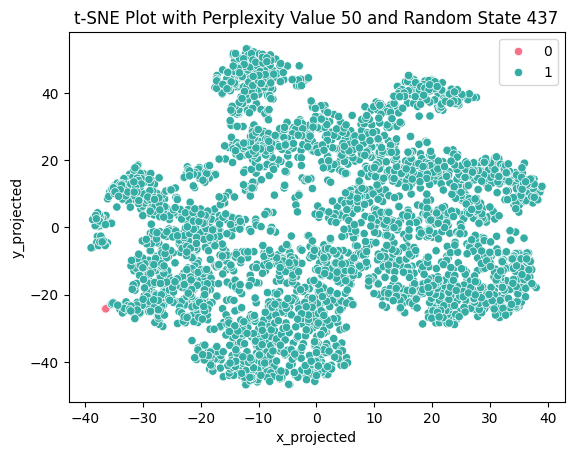

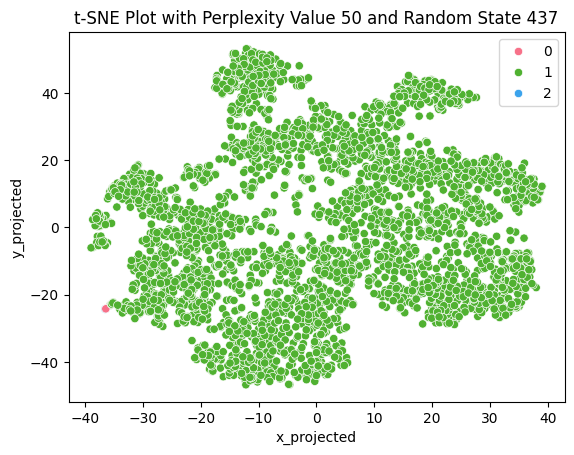

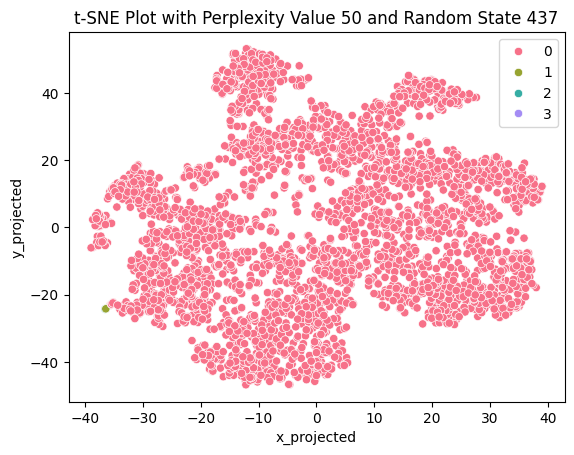

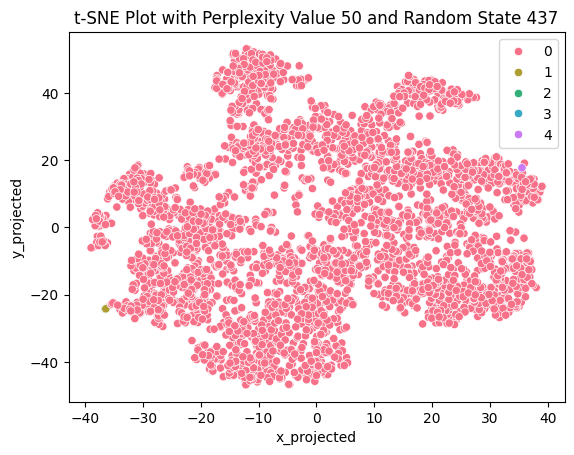

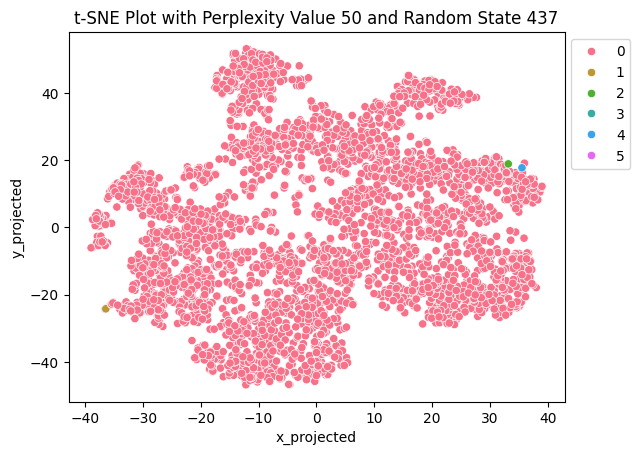

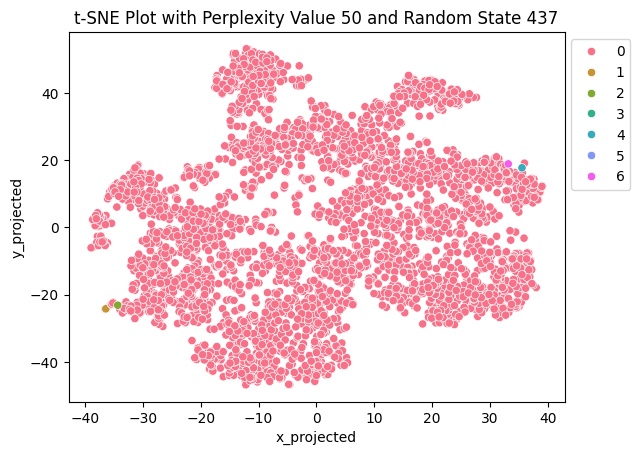

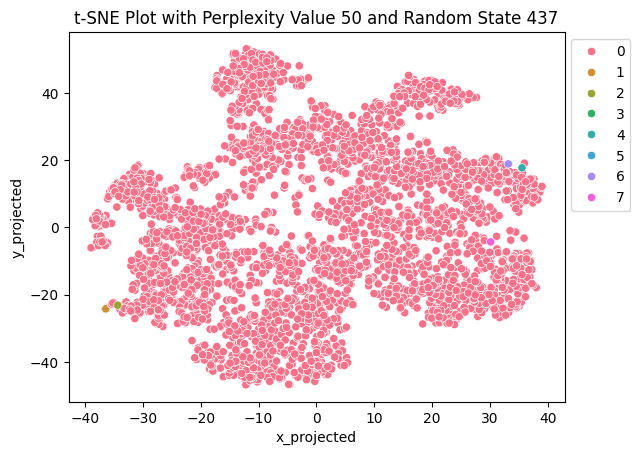

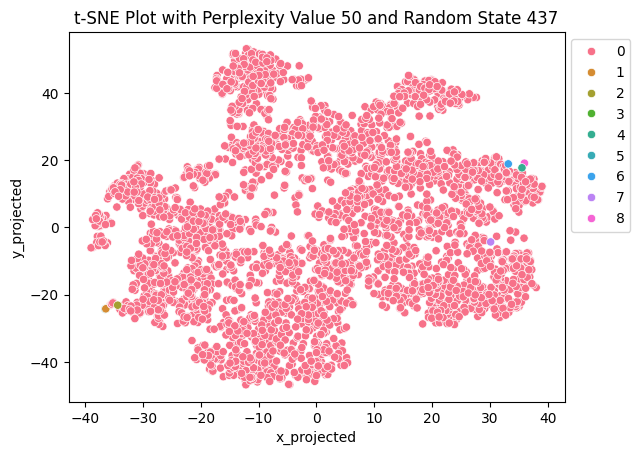

In [39]:
for k in range(2,10):
    #Clustering from dendrogram with k clusters
    hac = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='single')
    df_combo['predicted_cluster'] = hac.fit_predict(scale_data)

    #Map the resulting cluster labels onto our chosen t-SNE plot
    sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster', palette=sns.color_palette("husl", k), data=df_combo)
    plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(50, 437))
    plt.legend(bbox_to_anchor=(1,1))
    plt.show()

### HAC with Complete Linkage

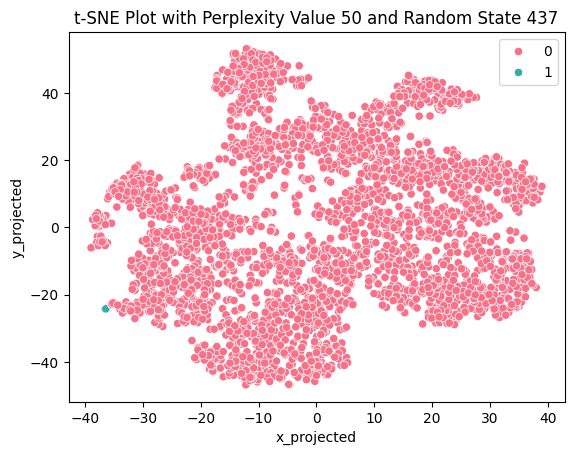

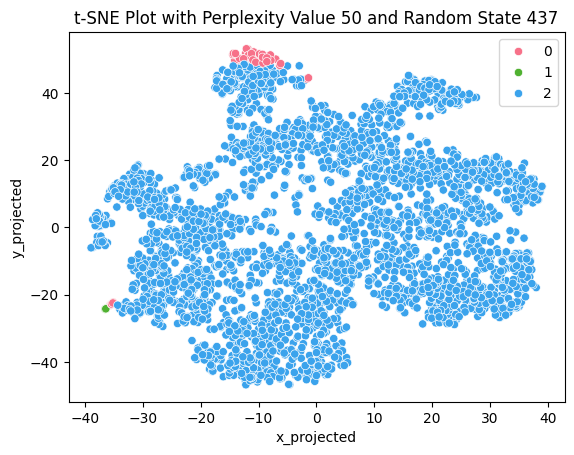

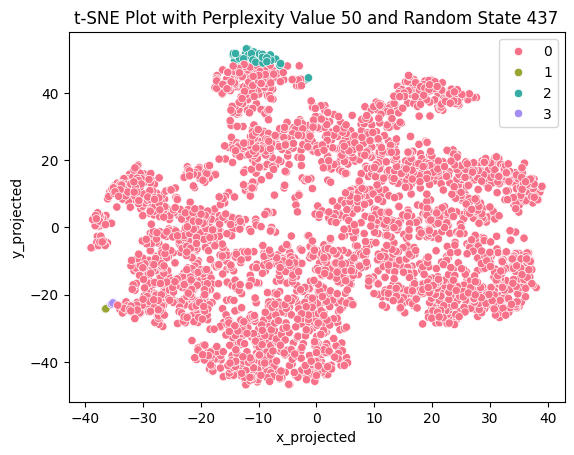

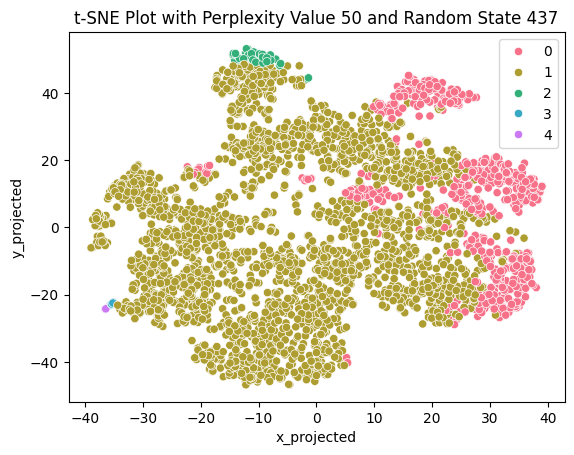

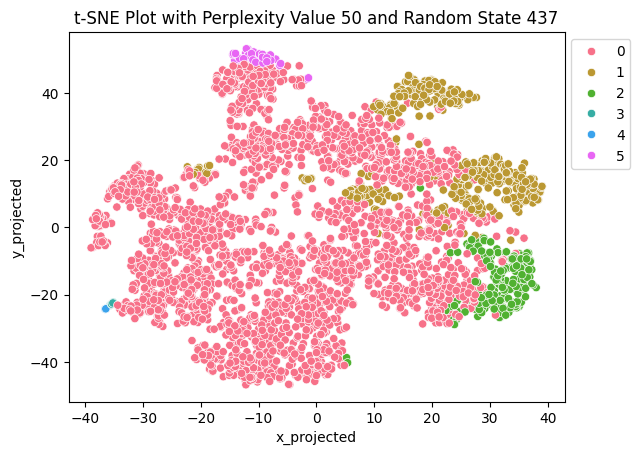

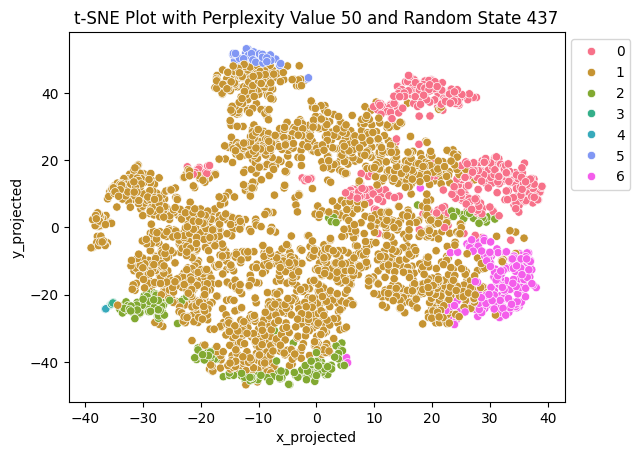

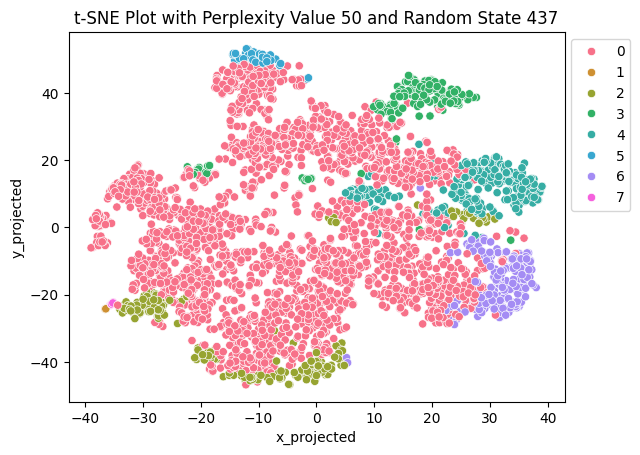

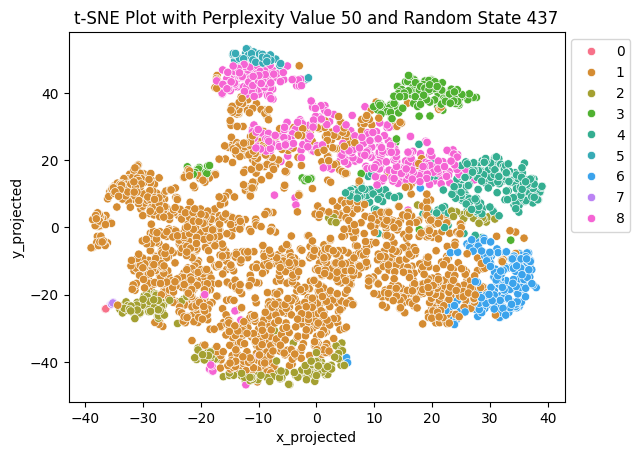

In [40]:
for k in range(2,10):
    #Clustering from dendrogram with k clusters
    hac = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='complete')
    df_combo['predicted_cluster'] = hac.fit_predict(scale_data)

    #Map the resulting cluster labels onto our chosen t-SNE plot
    sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster', palette=sns.color_palette("husl", k), data=df_combo)
    plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(50, 437))
    plt.legend(bbox_to_anchor=(1,1))
    plt.show()

### HAC with Average Linkage

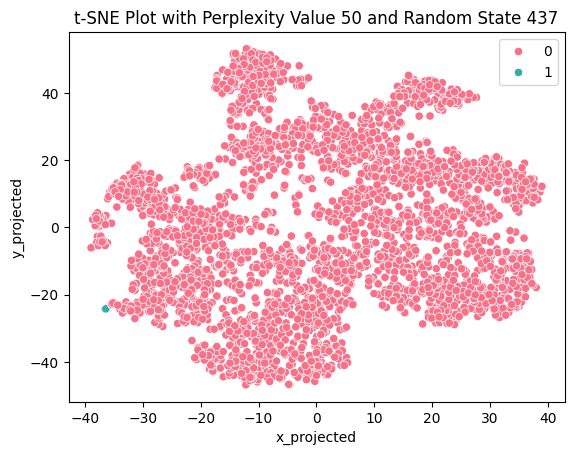

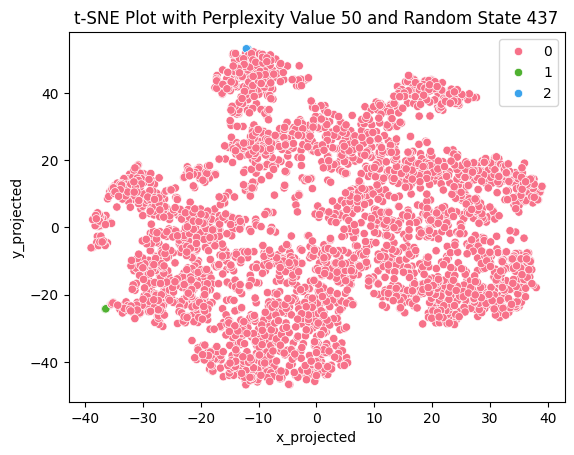

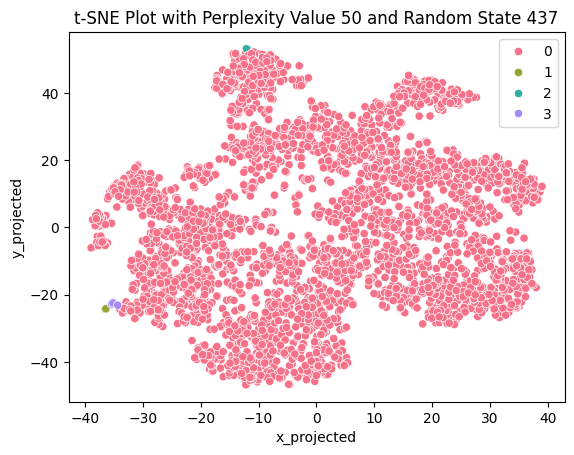

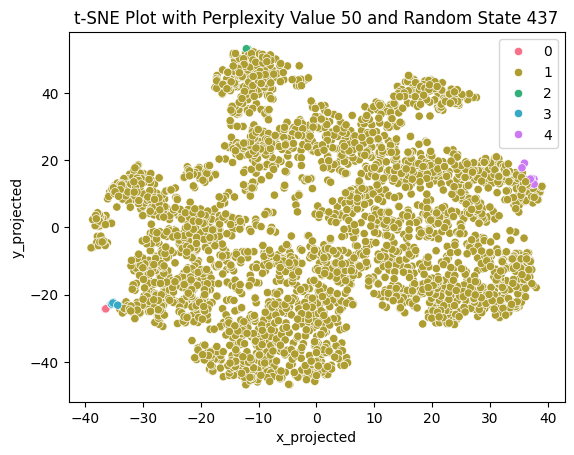

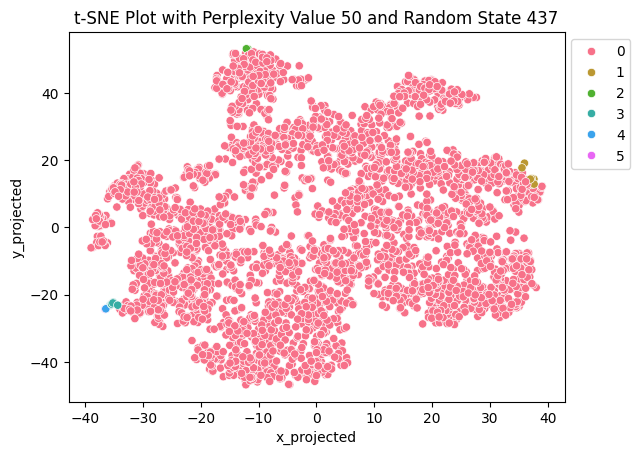

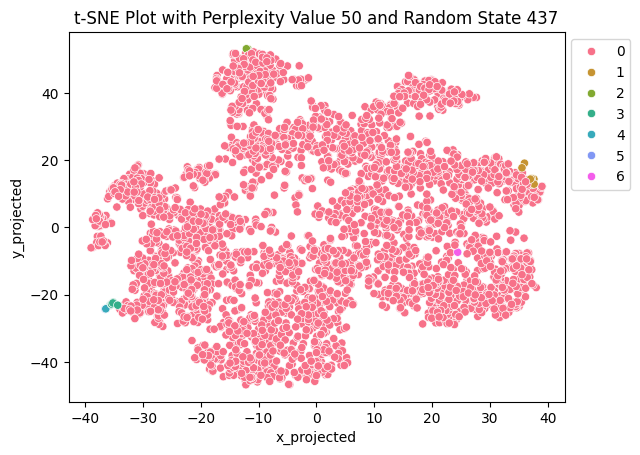

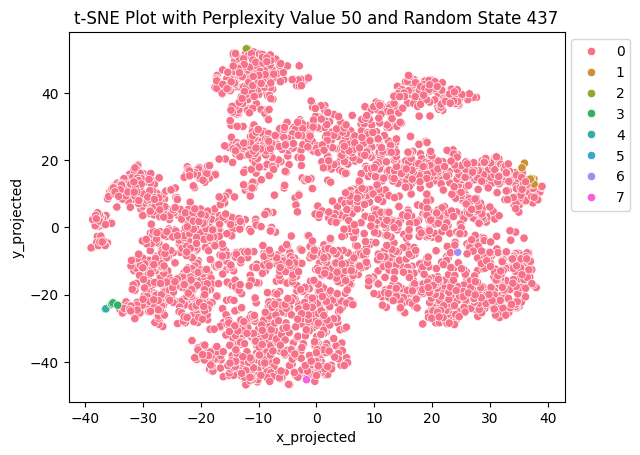

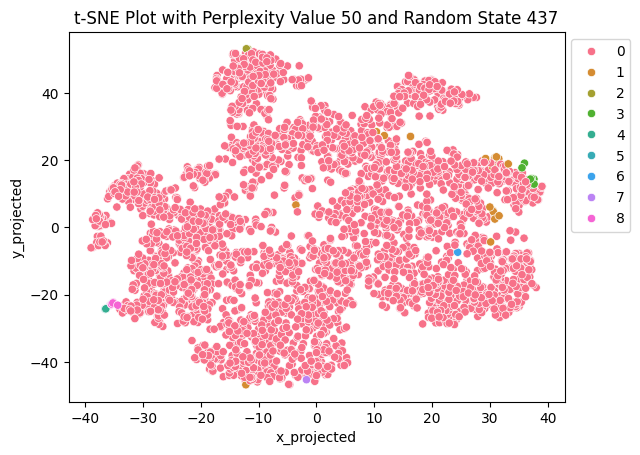

In [41]:
for k in range(2,10):
    #Clustering from dendrogram with k clusters
    hac = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='average')
    df_combo['predicted_cluster'] = hac.fit_predict(scale_data)

    #Map the resulting cluster labels onto our chosen t-SNE plot
    sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster', palette=sns.color_palette("husl", k), data=df_combo)
    plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(50, 437))
    plt.legend(bbox_to_anchor=(1,1))
    plt.show()

### HAC with Ward's Linkage

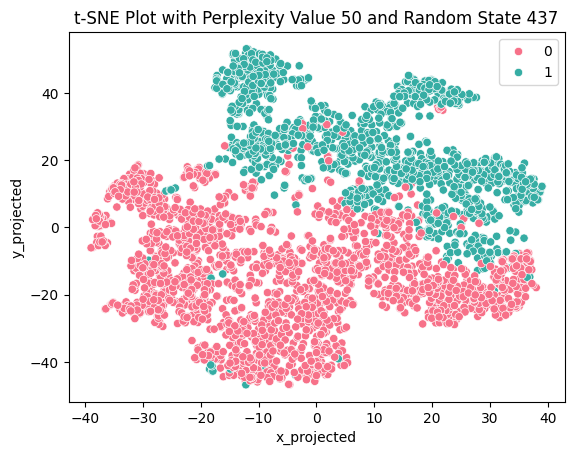

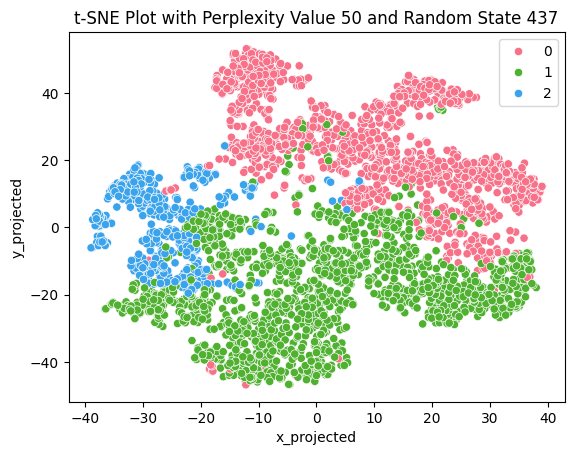

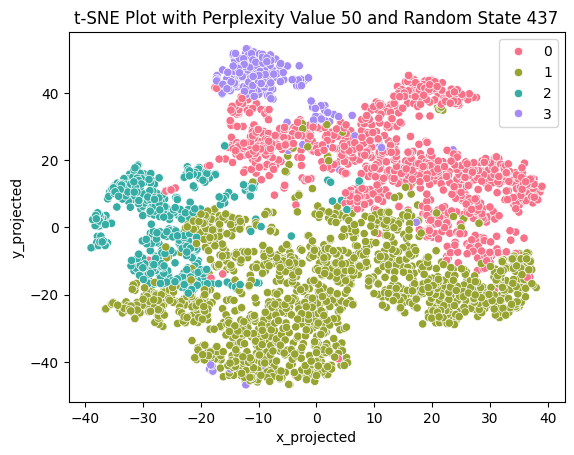

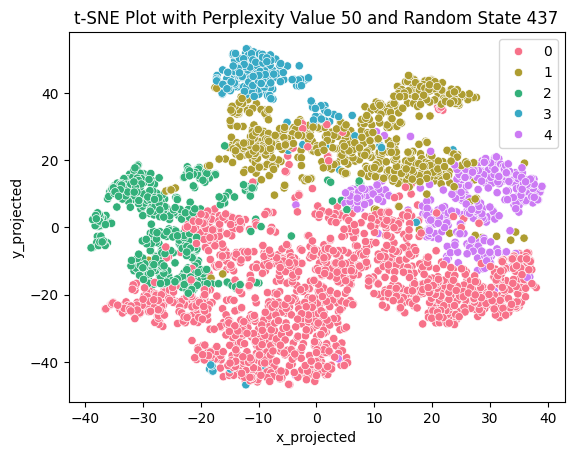

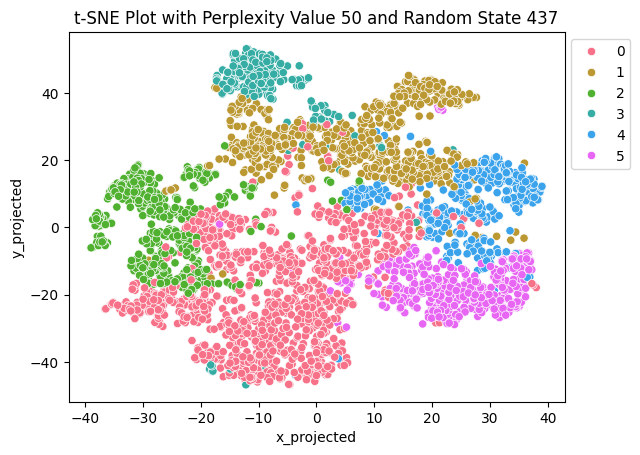

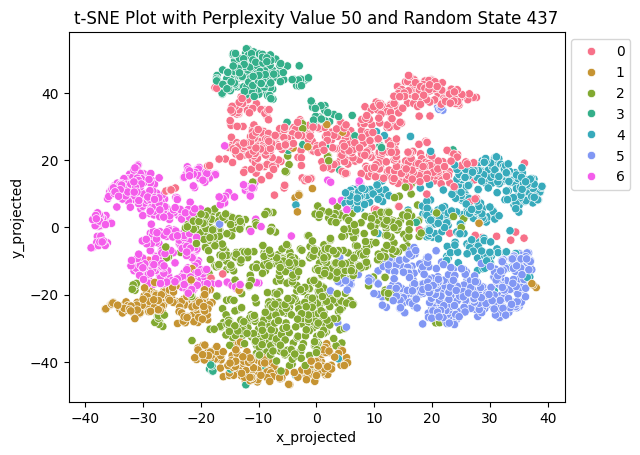

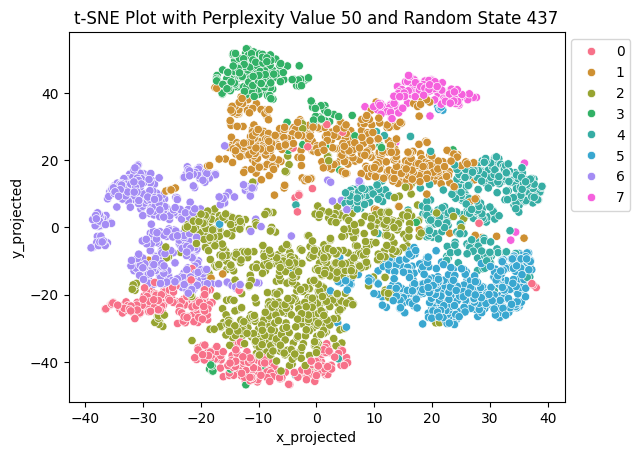

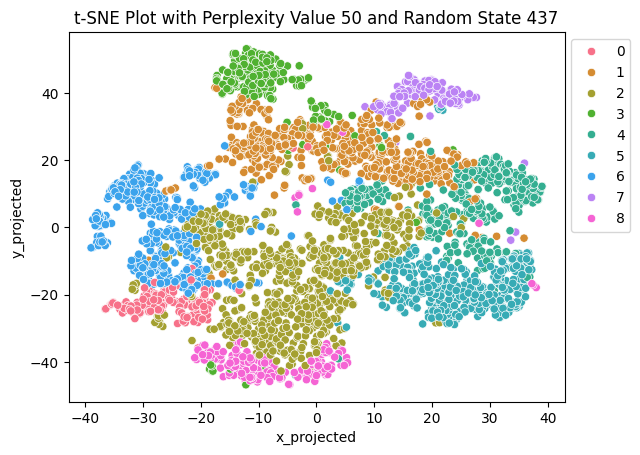

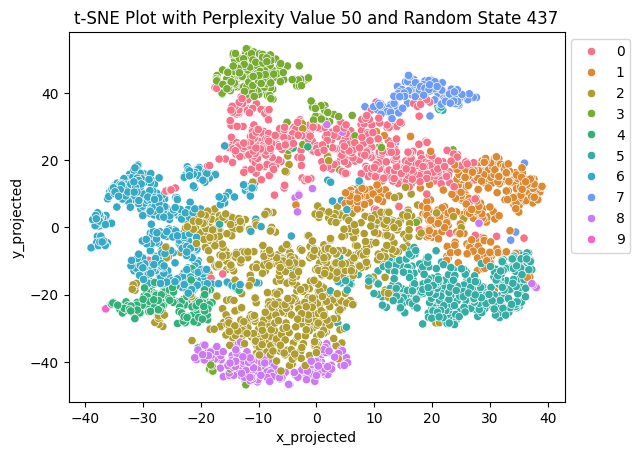

In [42]:
for k in range(2,11):
    #Clustering from dendrogram with k clusters
    hac = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='ward')
    df_combo['predicted_cluster'] = hac.fit_predict(scale_data)

    #Map the resulting cluster labels onto our chosen t-SNE plot
    sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster', palette=sns.color_palette("husl", k), data=df_combo)
    plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(50, 437))
    plt.legend(bbox_to_anchor=(1,1))
    plt.show()

### Average Silhouette Score

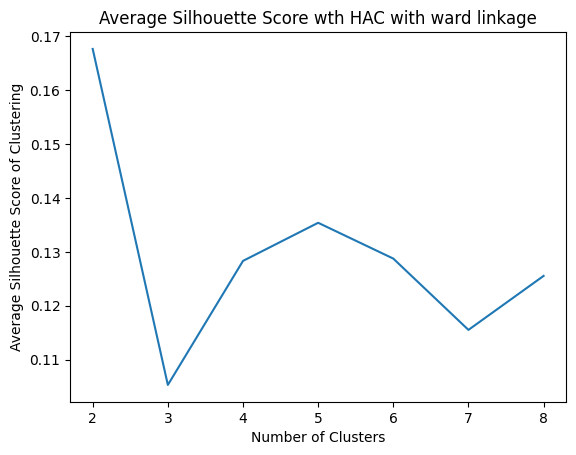

In [43]:
avg_ss=[]
for k in range(2,9):
    hac = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='ward')
    Y_pred = hac.fit_predict(scale_data)
    avg_ss.append(silhouette_score(scale_data, Y_pred))

plt.plot(range(2,9), avg_ss)
plt.title('Average Silhouette Score wth HAC with ward linkage')
plt.xlabel('Number of Clusters')
plt.ylabel('Average Silhouette Score of Clustering')
plt.show()

For HAC, we first needed to choose the linkage method. We tried each of the 4 linkages (single, complete, average, ward’s) and chose the one that visually (based on t-SNE) showed the most meaningful clusters. The best clustering was generated by HAC with ward’s linkage therefore we have decided to proceed with this model. The second parameter that we had to choose was the number of clusters. For that, we used the Average Silhouette Score: the highest score corresponds to k=5, so we proceeded with this number of clusters.

**Clustering Algorithm Results Presentation**

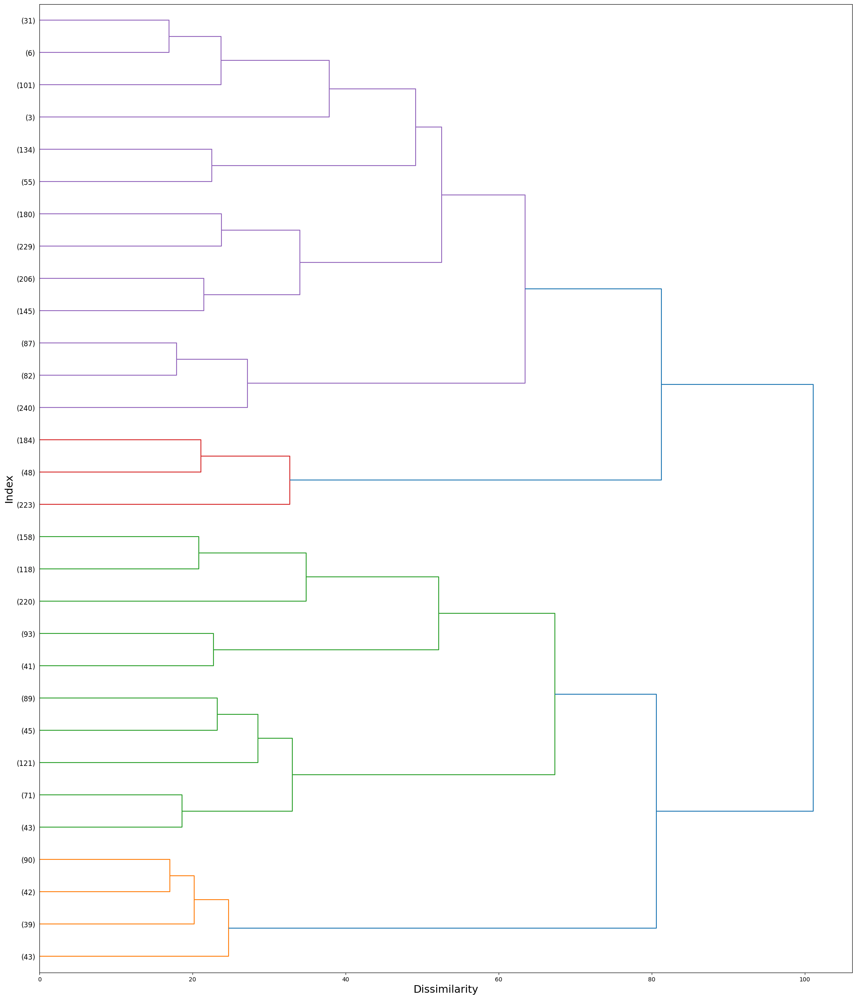

In [44]:
dm = pdist(scale_data, metric='euclidean')
single_link_fit = linkage(dm, method='ward')

fig, ax = plt.subplots(figsize=(25, 30))
d = dendrogram(single_link_fit, orientation='right', ax=ax, truncate_mode = 'lastp')
ax.set_xlabel('Dissimilarity', fontsize=18)
ax.set_ylabel('Index', fontsize=18)
plt.yticks(fontsize=12)
plt.show()

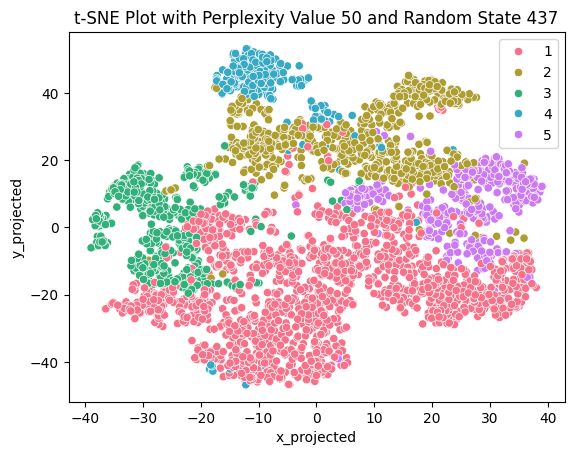

In [45]:
#Clustering from Dendrogram & Average Silhouette Score with 5 clusters
k=5
hac = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='ward')
df_combo['predicted_cluster'] = hac.fit_predict(scale_data)
df_combo['predicted_cluster'] = df_combo['predicted_cluster']+1

#Map the resulting cluster labels onto our chosen t-SNE plot
sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster', palette=sns.color_palette("husl", k), data=df_combo)
plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(50, 437))
plt.legend(bbox_to_anchor=(1,1))
plt.show()

Again, our main research goal was to find meaningful ways to cluster beer types. From the t-SNE plot with cluster labels, we may observe that HAC with ward’s linkage and k=5 did not perform perfectly well because Cluster 1 consists of multiple inherent clusters. If we look at the dendrogram, we may notice the same trend – there are a couple of clusters large in size, and others are relatively small. Moreover, the tree is more or less balanced.

Looking at the t-SNE plot we can see some instances where HAC with Ward’s split the inherent clusters, for example, the top middle inherent cluster is split into Cluster 4 and Cluster 2. We also can see that Cluster 1 consists of 3-4 inherent clusters that ideally should have been separate clusters.

In [46]:
df2['predicted_cluster'] = df_combo['predicted_cluster']
df_num2['predicted_cluster'] = df2['predicted_cluster']

**Additional Cluster Exploration**

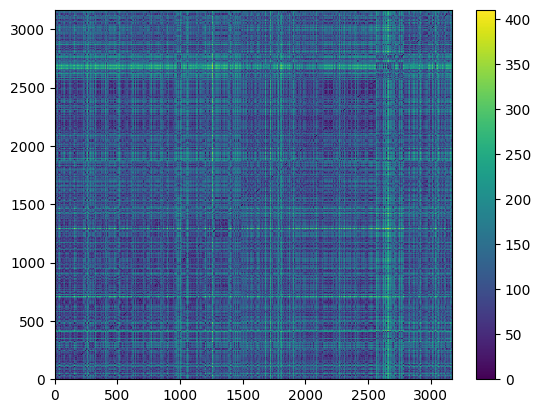

In [47]:
#Cluster similarity matrix
df_sort=df2.sort_values(by=['predicted_cluster']).drop(['predicted_cluster','Style','Name','Brewery'], axis=1)
dist_mat = squareform(pdist(df_sort))

#Then visualize the distance matrix with a heat map.
plt.pcolormesh(dist_mat)
plt.colorbar()
N = len(df_sort)
plt.xlim([0,N])
plt.ylim([0,N])
plt.show()

Just like with the first clustering algorithm, we did additional cluster exploration using several metrics. Looking at the Cluster Sorted SImilarity Matrix, there is only one small cluster that is furthest away from the other four clusters: a small square (roughly 2600-2700). The rest of the clusters are very close to each other.

For the purpose of this analysis, we have decided to use the Cluster Sorted Similarity matrix to check sparsity. From the heatmap, every cluster has the same large sparsity level. This is because we do not see clear dark squares on the heatmap that would indicate small sparsity within clusters.

For n_clusters = 5 The average silhouette score is : 0.13537904575124446


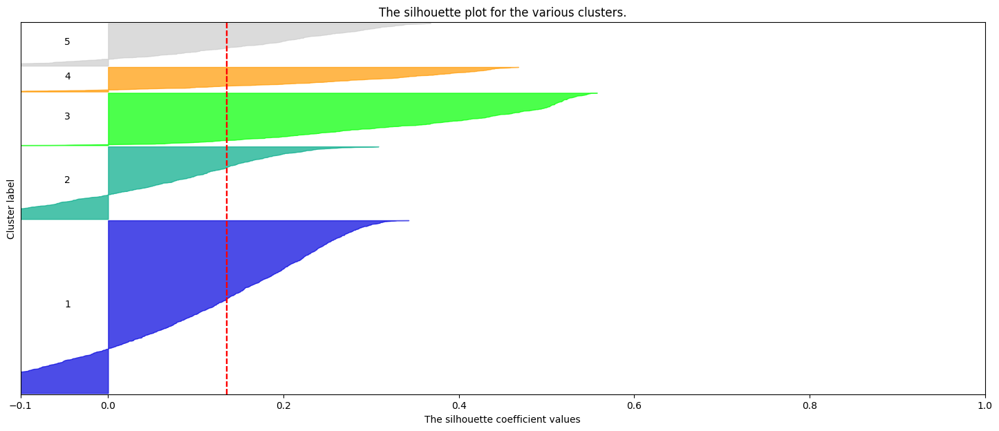

In [48]:
show_silhouette_plots(scale_data, df_combo["predicted_cluster"])

Looking at the Silhouette Plot, the highest cohesion corresponds to Cluster 3. The rest of the clusters have comparatively smaller cohesiveness. Regarding separation, Clusters 3 and 4 have the best separation because these clusters have the smallest number of negative silhouette scores.

In conclusion, HAC with ward’s algorithm did not result in singleton clusters, therefore, using the Cluster-Sorted Similarity Matrix and Silhouette Plot to evaluate cohesion and separation is confirmed to be reasonable.

**Describing Each of the Clusters**

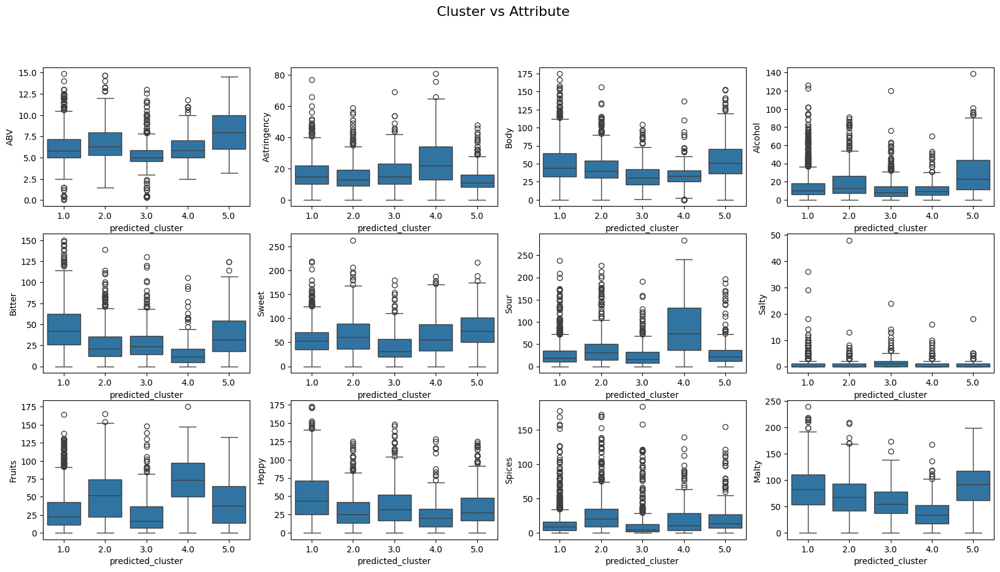

In [49]:
fig, ax = plt.subplots(3,4,figsize=(20,10))
fig.suptitle('Cluster vs Attribute', fontsize=16)

i=0
for col in df_num2.columns[0:-2]:
  sns.boxplot(ax=ax[int(np.floor(i/4)),int(i-4*np.floor(i/4))], x='predicted_cluster',y=col,data=df_num2)
  i = i+1
plt.show()

1. **Cluster 1: Pale Ale (Full Body/Bitter/Hoppy)**

According to the boxplot, we can see that cluster 1 has a full body mouth feel, with a bitter taste, and a hoppy flavor. Additionally, this cluster mostly composed of Pale Ale, IPA and Stout.

In [50]:
# Cluster 1
df2[df2['predicted_cluster']==1]['Style'].value_counts().head(6)

Style
Pale Ale - English     39
Bitter - English       39
Brown Ale - English    37
IPA - American         37
IPA - English          37
Stout - Irish Dry      37
Name: count, dtype: int64

2. **Cluster 2: Dark Beer (High ABV/Sweet/Spicy & Fruity)**

According to the boxplot, we can see that cluster 2 has a high alcohol content, with a sweet taste, as well as spicy and fruity flavor. Additionally, this cluster mostly composed of Dunkel, Dubbel and Dark ale.

In [51]:
# Cluster 2
df2[df2['predicted_cluster']==2]['Style'].value_counts().head(6)

Style
Wheat Beer - Dunkelweizen    34
Dubbel                       33
Strong Ale - Belgian Dark    29
Wheat Beer - Hefeweizen      24
Fruit and Field Beer         23
Blonde Ale - Belgian         23
Name: count, dtype: int64

3. **Cluster 3: Lager (Light beer)**

According to the boxplot, we can see that cluster 3 has a lowest value for all the characteristics, including mouthfeel, alcohol content, taste and flavor. Additionally, this cluster mostly composed of the Lager.

In [52]:
# Cluster 3 - Lager (all mostly lowest)
df2[df2['predicted_cluster']==3]['Style'].value_counts().head(6)

Style
Lager - Light                 32
Lager - Adjunct               31
Lambic - Traditional          22
Lager - European Pale         21
Low Alcohol Beer              19
Gruit / Ancient Herbed Ale    17
Name: count, dtype: int64

4. **Cluster 4: Wheat beer (High Astringency/Sour/Fruity)**

According to the boxplot, we can see that cluster 4 has a high astringency mouth feel, with a sour taste, and a fruity flavor. Additionally, this cluster mostly composed of Lambic, Wheat beer and some sour ale.

In [53]:
# Cluster 4
df2[df2['predicted_cluster']==4]['Style'].value_counts().head(6)

Style
Lambic - Fruit               38
Wheat Beer - Witbier         24
Sour - Flanders Oud Bruin    18
Lambic - Gueuze              16
Smoked Beer                  16
Farmhouse Ale - Saison       15
Name: count, dtype: int64

5. **Cluster 5: Strong Ale (Highest ABV and Full Body/Bitter & Sweet/Malty & Hoppy)**

According to the boxplot, we can see that cluster 5 has a highest alcohol content and full body mouth feel, with a bitter and sweet taste, as well as malty and hoppy flavor. Additionally, this cluster mostly composed of Barleywine and some Bock.

In [54]:
# Cluster 5
df2[df2['predicted_cluster']==5]['Style'].value_counts().head(6)

Style
Barleywine - American      36
Bock - Doppelbock          26
Lager - European Strong    18
Barleywine - English       17
Quadrupel (Quad)           17
Scotch Ale / Wee Heavy     15
Name: count, dtype: int64

***

## 10. Discussion

**Clustering Comparison: WHAT was different?**

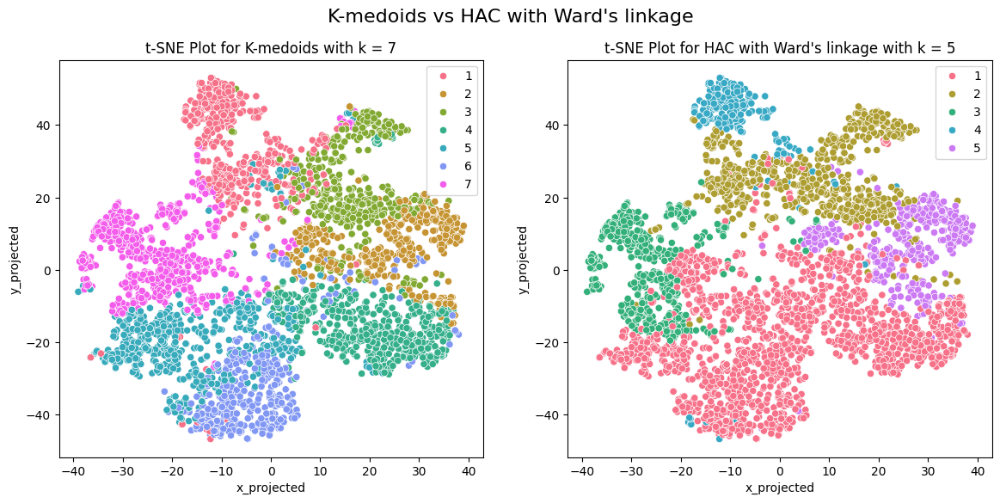

In [55]:
fig, ax = plt.subplots(1,2,figsize=(14,6))
fig.suptitle("K-medoids vs HAC with Ward's linkage", fontsize=16)

sns.scatterplot(ax=ax[0],x='x_projected',y='y_projected', hue='predicted_cluster_kmedoids',
                palette=sns.color_palette("husl", 7), data=df_combo)
ax[0].set_title('t-SNE Plot for K-medoids with k = 7')
ax[0].legend(bbox_to_anchor=(1,1))

sns.scatterplot(ax=ax[1],x='x_projected',y='y_projected', hue='predicted_cluster',
                palette=sns.color_palette("husl", 5), data=df_combo)
ax[1].set_title("t-SNE Plot for HAC with Ward's linkage with k = 5")
ax[1].legend(bbox_to_anchor=(1,1))

plt.show()

According to our clustering result, K-medoid has an optimal number of clusters equal to 7, while HAC with Ward’s linkage has an optimal number of clusters equal to 5 based on the average silhouette score. From the t-SNE plot comparison, we found that HAC has one main cluster composed of 3 subclusters shown in K-medoid, while other clusters look similar for both algorithms with slightly different for group members.

K-medoids tend to have a higher ability to identify the inherent clusters to be in the shape of petals as we can see in the t-SNE plot, while HAC is worse at capturing this information. According to our research goal, we expected that our clustering results should have a clear distinct characteristic, so it should reflect a meaningful separation of clusters. Based on this assumption, K-medoid performs better in terms of identifying inherent clusters, which results in more trustworthy results than HAC with Ward’s linkage.

**Clustering Comparion: Clustering Insights**

**Algorithm 1: K-medoids**


From the K-medoids result, we found that those 7 clusters are composed of:

1. Wheat Beer (High Astringency/Sour/Fruity)
2. Strong Ale (Highest ABV/Sweet/Malty)
3. Dark Beer (High ABV/Sweet/Spicy & Fruity)
4. Roasted Ale (Full Body/Bitter/Malty)
5. Pilsner (High Astringency/Bitter & Salty/Hoppy)
6. IPA (High ABV/most Bitter/Hoppy & Fruity)
7. Lager (Light beer)

**Algorithm 2: HAC with Ward’s linkage**

From HAC with Ward’s linkage result, we found that those 5 clusters are composed of:

1. Wheat Beer (High Astringency/Sour/Fruity)
2. Strong Ale (Highest ABV and Full Body/Bitter & Sweet/Malty)
3. Dark Beer (High ABV/Sweet/Spicy & Fruity)
4. Pale Ale (Full Body/Bitter/Hoppy & Malty)
5. Lager (Light beer)

According to our findings, most of the clustering results look really alike, except for the cluster of ‘Pale Ale’, which is composed of 3 subclusters (Pale ale, IPA, and Stout). For ‘Pilsner’ that we found in K-medoids, it seems to have a characteristic close to ‘Lager’ with a more bitter and hoppy flavor, which is close to the ‘Pale Ale’ characteristic. Hoppy beers have a bitter or floral flavor. Therefore, these two types of beer tend to be hard to distinguish from our both clustering algorithms due to similar characteristics.


## 11. Conclusion

**Summary**

In the coming years, demand for specialty beers will increase. The goal of our research was to identify distinct beer types and flavor profiles that a business owner can use to create a well-represented inventory of beers. Our clustering algorithms answer this research goal through K-Medoids and HAC with Ward’s linkage, which revealed 7 distinct beer clusters and 5 distinct beer clusters, respectively.

**Recommendation**

As a team, we strongly believe that the insights extracted from clustering analysis are beneficial for the prospective brewery owner and we highly recommend using our report as of source of information about distinct beer types. Our report shows that K-Medoids found 7 distinct clusters, which is more insightful than HAC with Ward’s because it further distinguishes 2 other clusters. Our recommendation for business owner to select 1 type of beer in each cluster to create a representative sample of specialty beers in his inventory. According to our findings, we would like to suggest those 7 categories of beer from K-medoids, which are Wheat beer (Witbier/Lambic), Strong ale (Barleywine/Bock), Dark beer (Dunkel/Dubbel), Roasted Ale (Stout/Porter), IPA, Lager and one last category could be Pilsner or Pale Ale that have similar characteristics to be representatives for overall crafted beer profile in the markets. This strategic approach to product selection and development can lead to increased customer satisfaction and increased sales, making clustering insights extremely valuable for business success in a competitive market.

**Shortcomings/Caveats**

Although our t-SNE plots and clustering algorithms answered our research goal, there may be a few shortcomings. For example, our dataset did not have perfect cluster separation as seen in k-Medoids and may have produced overly simple beer categories given 3197 unique beers but only 5-7 distinct clusters at the end. Despite these shortcomings, we believe our analysis remains strong since results are justified with multiple algorithms and outputs.

**Future Work**

Based on the current findings from our analysis, we can include additional variables into the dataset, such as consumer demographic data or geographic sales data to see how these factors influence beer preferences and cluster formations. Additionally, we could add data track of changes in consumer preferences over time, where we could try to find the correlation with events that might cause the change of preference, for example Oktoberfest. All of these future insights could further benefit the main motivational research goal of helping prospective beer brewery entrepreneurs.

## References

* “Global Craft Beer Market Report and
Forecast 2024-2032 .” Expert Market Research, www.expertmarketresearch.com/reports/craft-beer-market. Accessed 4 May 2024.

* “How Many Beer Styles Are There?” Tapville Social, Tapville Social, 13 Mar. 2023, www.tapvillesocial.com/cheers-n-eats/2018/5/22/how-many-beer-styles-are-there.

* Jack, John. “Beer Market Primed for Remarkable Growth.” Beer Market Analysis, Growth, Trends [2023-2027], 1 Apr. 2024, www.linkedin.com/pulse/beer-market-primed-remarkable-growth-anticipating-substantial-jack-ungfc/.